# Projekat 2 - Nenadgledano učenje (klasterizacija)

## 1. Priprema podataka

Importovanje potrebnih biblioteka i učitavanje dataset-a:

In [150]:
%matplotlib inline

import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns

dataframe = pd.read_csv("C:/Users/filip/Documents/master/ML/Projekat 2/data/dataset-tortuga.csv")
dataframe

,Unnamed: 0,NAME,USER_ID,HOURS_DATASCIENCE,HOURS_BACKEND,HOURS_FRONTEND,NUM_COURSES_BEGINNER_DATASCIENCE,NUM_COURSES_BEGINNER_BACKEND,NUM_COURSES_BEGINNER_FRONTEND,NUM_COURSES_ADVANCED_DATASCIENCE,NUM_COURSES_ADVANCED_BACKEND,NUM_COURSES_ADVANCED_FRONTEND,AVG_SCORE_DATASCIENCE,AVG_SCORE_BACKEND,AVG_SCORE_FRONTEND,PROFILE
0,28,Stormy Muto,58283940,7.0,39.0,29.0,2.0,4.0,0.0,2.0,5.0,0.0,84.0,74.0,NaN,beginner_front_end
1,81,Carlos Ferro,1357218,32.0,0.0,44.0,2.0,0.0,0.0,0.0,5.0,0.0,67.0,45.0,NaN,beginner_front_end
2,89,Robby Constantini,63212105,45.0,0.0,59.0,0.0,5.0,4.0,0.0,4.0,1.0,NaN,54.0,47.0,advanced_front_end
3,138,Paul Mckenny,23239851,36.0,19.0,28.0,0.0,5.0,7.0,0.0,5.0,3.0,NaN,71.0,89.0,beginner_data_science
4,143,Jean Webb,72234478,61.0,78.0,38.0,6.0,11.0,0.0,4.0,3.0,0.0,66.0,85.0,NaN,advanced_front_end
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
19995,20495,Rose Jurado,66754730,0.0,44.0,42.0,8.0,4.0,7.0,3.0,3.0,3.0,74.0,73.0,93.0,advanced_backend
19996,20496,Johnny Jones,6874888,0.0,85.0,63.0,3.0,5.0,0.0,4.0,7.0,3.0,50.0,83.0,94.0,advanced_front_end
19997,20497,Lawrence Givens,83752787,32.0,50.0,22.0,0.0,4.0,0.0,6.0,2.0,3.0,61.0,81.0,75.0,advanced_backend
19998,20498,Betty Diclaudio,45806698,0.0,96.0,69.0,3.0,3.0,3.0,5.0,7.0,4.0,64.0,68.0,68.0,advanced_front_end


---------

**Informacije o dataset-u i tipovima atributa**

Dataset sadrzi podatke o 20000 studenata IT sektora.
Sastoji se od 16 atributa(kolona) i 20000 vrsta(opservacija). Svaka vrsta predstavlja jednog IT studenta. Prva kolona pod imenom Unnamed ne daje apsolutno nikakvu informaciju. Ostale kolone sadrze informacije o broju sati ucenja, broju pohadjanih kurseva i prosecnim ocenama iz tri oblasti IT-a: Data science, Backend i Front-End. Poslednja kolona predstavlja profil studenta koji moze imati vrednost Beginner Backend, Beginner Front-End, Beginner Data Science, Advanced Backend, Advanced Front-End, Advanced Data Science.
Cilj ovog projekta je da se, na osnovu ovih mera/karakteristika, studenti sto bolje podele, tako da pripadaju nekom od ovih profila. Kolona PROFILE ce sluziti kao Ground Truth Label, tj u odnosu na nju se procenjuje da li je izvrsena klasterizacija dobra.

---------------------

In [151]:
dataframe.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 20000 entries, 0 to 19999
Data columns (total 16 columns):
 #   Column                            Non-Null Count  Dtype  
---  ------                            --------------  -----  
 0   Unnamed: 0                        20000 non-null  int64  
 1   NAME                              20000 non-null  object 
 2   USER_ID                           20000 non-null  int64  
 3   HOURS_DATASCIENCE                 19986 non-null  float64
 4   HOURS_BACKEND                     19947 non-null  float64
 5   HOURS_FRONTEND                    19984 non-null  float64
 6   NUM_COURSES_BEGINNER_DATASCIENCE  19974 non-null  float64
 7   NUM_COURSES_BEGINNER_BACKEND      19982 non-null  float64
 8   NUM_COURSES_BEGINNER_FRONTEND     19961 non-null  float64
 9   NUM_COURSES_ADVANCED_DATASCIENCE  19998 non-null  float64
 10  NUM_COURSES_ADVANCED_BACKEND      19992 non-null  float64
 11  NUM_COURSES_ADVANCED_FRONTEND     19963 non-null  float64
 12  AVG_

---------------------

Svi atributi sem prvra tri i poslednjeg su kontinualni, numerickog tipa. Poslednji atribut je nominalni, kategorickog tipa. Prva tri atributa nisu od znacaja za klasterizaciju, pa su u celiji ispod uklonjeni.

---------------------

In [152]:
dataframe = dataframe.drop(['Unnamed: 0', 'NAME', 'USER_ID'], axis=1)
dataframe.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 20000 entries, 0 to 19999
Data columns (total 13 columns):
 #   Column                            Non-Null Count  Dtype  
---  ------                            --------------  -----  
 0   HOURS_DATASCIENCE                 19986 non-null  float64
 1   HOURS_BACKEND                     19947 non-null  float64
 2   HOURS_FRONTEND                    19984 non-null  float64
 3   NUM_COURSES_BEGINNER_DATASCIENCE  19974 non-null  float64
 4   NUM_COURSES_BEGINNER_BACKEND      19982 non-null  float64
 5   NUM_COURSES_BEGINNER_FRONTEND     19961 non-null  float64
 6   NUM_COURSES_ADVANCED_DATASCIENCE  19998 non-null  float64
 7   NUM_COURSES_ADVANCED_BACKEND      19992 non-null  float64
 8   NUM_COURSES_ADVANCED_FRONTEND     19963 non-null  float64
 9   AVG_SCORE_DATASCIENCE             19780 non-null  float64
 10  AVG_SCORE_BACKEND                 19916 non-null  float64
 11  AVG_SCORE_FRONTEND                19832 non-null  float64
 12  PROF

---------

**Nedostajuce vrednosti i duplikati**

In [153]:
dataframe.isnull().sum()

HOURS_DATASCIENCE                    14
HOURS_BACKEND                        53
HOURS_FRONTEND                       16
NUM_COURSES_BEGINNER_DATASCIENCE     26
NUM_COURSES_BEGINNER_BACKEND         18
NUM_COURSES_BEGINNER_FRONTEND        39
NUM_COURSES_ADVANCED_DATASCIENCE      2
NUM_COURSES_ADVANCED_BACKEND          8
NUM_COURSES_ADVANCED_FRONTEND        37
AVG_SCORE_DATASCIENCE               220
AVG_SCORE_BACKEND                    84
AVG_SCORE_FRONTEND                  168
PROFILE                               0
dtype: int64

In [154]:
_IZBACITI_SVE = True

if _IZBACITI_SVE:
    for feature_index in dataframe.columns:
        indices = dataframe.index[dataframe[feature_index].isnull()].to_list()
        dataframe = dataframe.drop(indices, axis=0).reset_index(drop=True)
else:
    for feature_index in dataframe.columns[:9]:
        dataframe[feature_index] = dataframe[feature_index].replace(np.nan, dataframe[feature_index].mean())
    
    dataframe_zeroes = dataframe.copy()
    for feature_index in dataframe.columns[-4:-1]:
        dataframe_zeroes[feature_index] = dataframe[feature_index].replace(np.nan, dataframe[feature_index].mean())
    
    for feature_index in dataframe.columns[-4:-1]:
        indices = dataframe.index[dataframe[feature_index].isnull()].to_list()
        dataframe = dataframe.drop(indices, axis=0).reset_index(drop=True)

# dataframe.isnull().sum()

---------------------

Ima nedostajucih vrednosti, odluceno je da se redovi sa nedostajucim vrednostima izbace, buduci da ih nema puno u odnosu na broj redova u dataset-u a i sumnja se da su te nedostajuce vrednosti nasumicno ubacivane po dataset-u.

---------------------

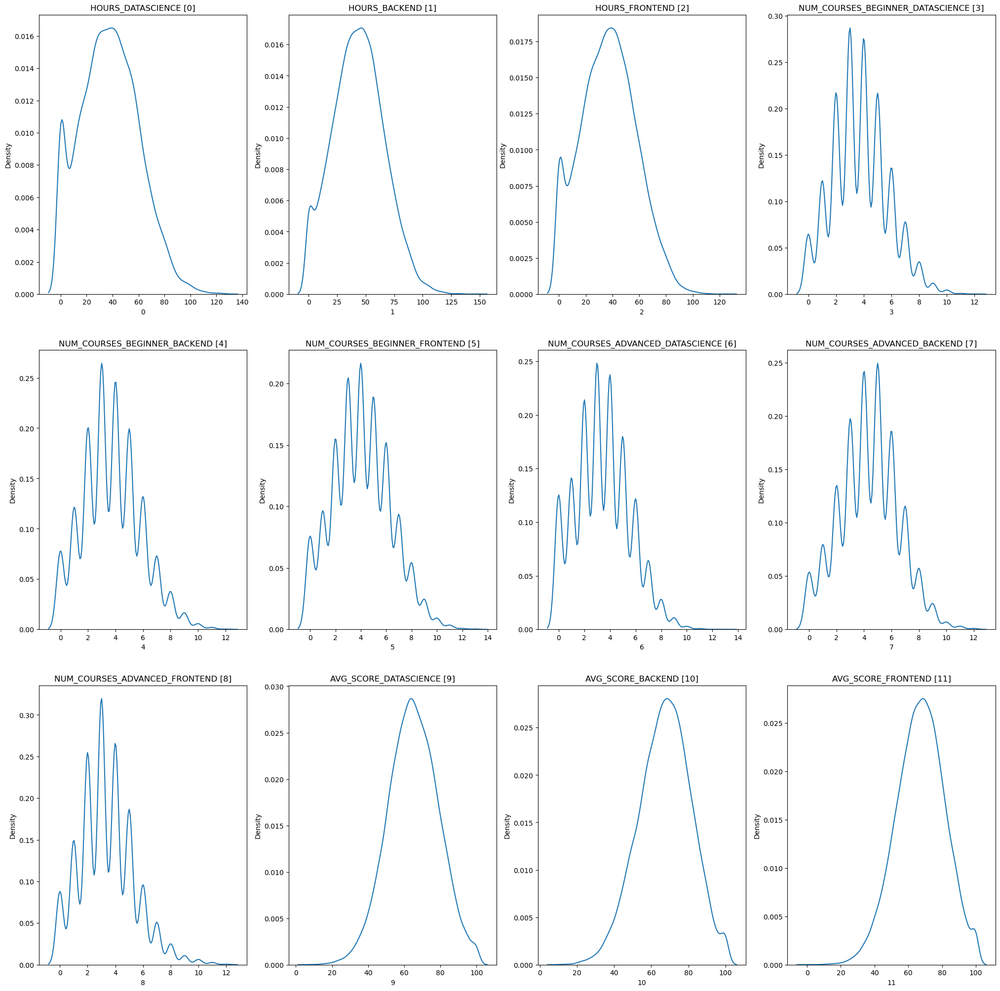

In [155]:
df = dataframe.drop(['PROFILE'], axis=1)
potential_features_to_show = df.to_numpy()

mod_df = pd.DataFrame(potential_features_to_show)
fig, axs = plt.subplots(3,4, figsize=(25,25))
for i in range(3):
    for j in range(4):
        sns.kdeplot(mod_df[4*i+j], ax=axs[i][j])
        axs[i][j].set_title('{} [{}]'.format(df.columns[4*i+j],4*i+j))
plt.show()

--------------------------------------

Podaci su dosta dobro distribuirani. Vidi sa na dijagramima da nema znacajnog broja outlier-a.

---------------------

In [9]:
dataframe.describe()

,HOURS_DATASCIENCE,HOURS_BACKEND,HOURS_FRONTEND,NUM_COURSES_BEGINNER_DATASCIENCE,NUM_COURSES_BEGINNER_BACKEND,NUM_COURSES_BEGINNER_FRONTEND,NUM_COURSES_ADVANCED_DATASCIENCE,NUM_COURSES_ADVANCED_BACKEND,NUM_COURSES_ADVANCED_FRONTEND,AVG_SCORE_DATASCIENCE,AVG_SCORE_BACKEND,AVG_SCORE_FRONTEND
count,19328.000000,19328.000000,19328.000000,19328.000000,19328.000000,19328.000000,19328.000000,19328.000000,19328.000000,19328.000000,19328.000000,19328.000000
mean,37.673013,43.571502,36.996120,3.729046,3.727183,4.073210,3.421668,4.345664,3.396782,65.014694,67.321916,67.200124
std,22.358256,22.326112,20.547631,1.983035,2.092130,2.274433,2.096466,2.135325,1.972702,13.935712,14.186334,14.369522
min,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,7.000000,10.000000,0.000000
25%,21.000000,28.000000,22.000000,2.000000,2.000000,2.000000,2.000000,3.000000,2.000000,56.000000,58.000000,58.000000
50%,37.000000,43.000000,37.000000,4.000000,4.000000,4.000000,3.000000,4.000000,3.000000,65.000000,68.000000,68.000000
75%,53.000000,59.000000,51.000000,5.000000,5.000000,6.000000,5.000000,6.000000,5.000000,75.000000,77.000000,77.000000
max,127.000000,147.000000,124.000000,12.000000,12.000000,13.000000,13.000000,12.000000,12.000000,100.000000,100.000000,100.000000


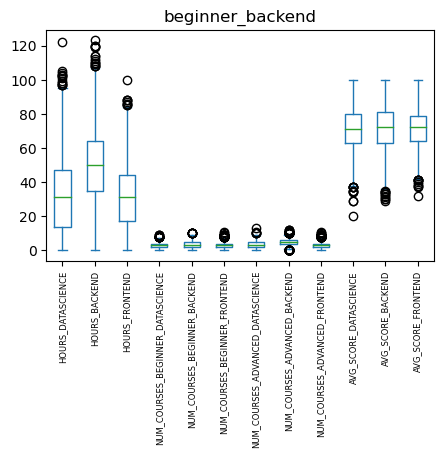

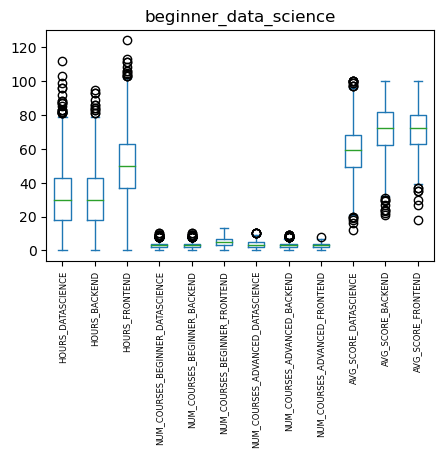

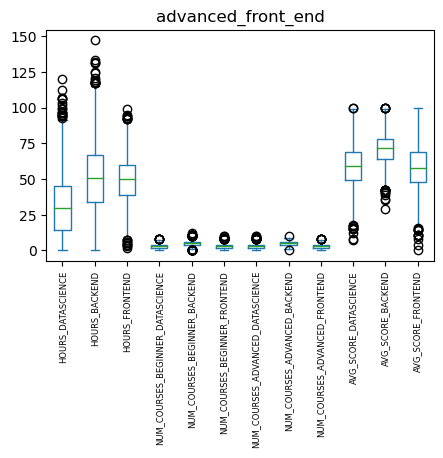

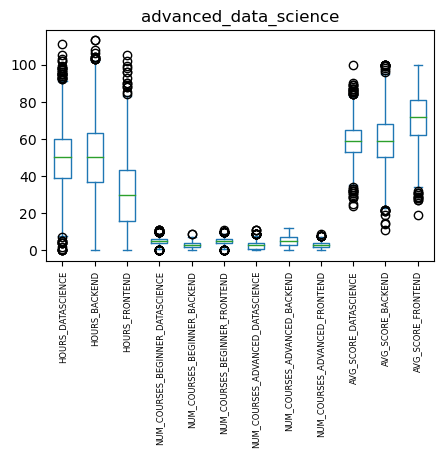

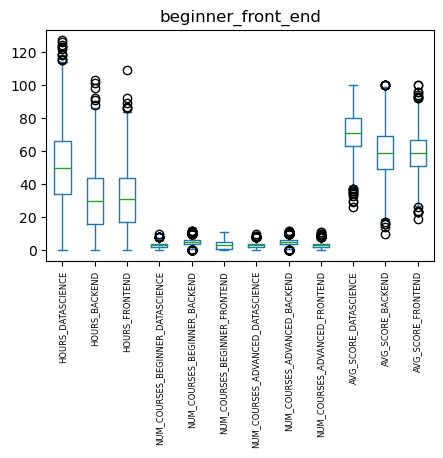

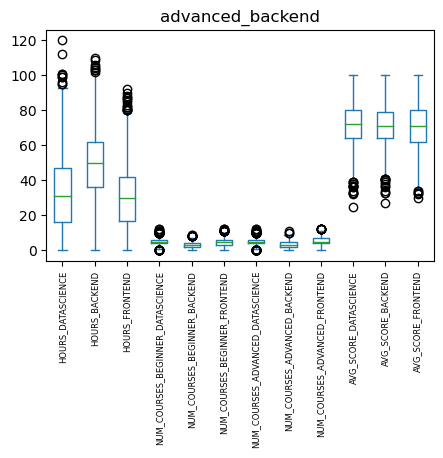

In [11]:
for val in dataframe['PROFILE'].unique():
    dataframe[dataframe['PROFILE'] == val].plot(kind='box', figsize=(5,3))
    plt.title(val)
    plt.xticks(rotation=90, fontsize=6)
    plt.show()

--------------------------------------

Na osnovu ovih dijagrama vec moze da se nasluti da profili nisu intuitivno dodeljeni studentima.

----------------

In [12]:
dataframe.shape

(19328, 13)

In [13]:
dataframe.drop_duplicates().shape

(19328, 13)

---------------------

Nema duplikata u dataset-u.

-------------

In [156]:
dataframe['PROFILE'].value_counts()

advanced_backend         3263
advanced_data_science    3250
advanced_front_end       3244
beginner_data_science    3215
beginner_front_end       3209
beginner_backend         3147
Name: PROFILE, dtype: int64

--------------------------------------

---------------------

In [157]:
dataframe_profiles = dataframe['PROFILE'].copy()
dataframe.drop('PROFILE', axis=1, inplace=True)
dataframe.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 19328 entries, 0 to 19327
Data columns (total 12 columns):
 #   Column                            Non-Null Count  Dtype  
---  ------                            --------------  -----  
 0   HOURS_DATASCIENCE                 19328 non-null  float64
 1   HOURS_BACKEND                     19328 non-null  float64
 2   HOURS_FRONTEND                    19328 non-null  float64
 3   NUM_COURSES_BEGINNER_DATASCIENCE  19328 non-null  float64
 4   NUM_COURSES_BEGINNER_BACKEND      19328 non-null  float64
 5   NUM_COURSES_BEGINNER_FRONTEND     19328 non-null  float64
 6   NUM_COURSES_ADVANCED_DATASCIENCE  19328 non-null  float64
 7   NUM_COURSES_ADVANCED_BACKEND      19328 non-null  float64
 8   NUM_COURSES_ADVANCED_FRONTEND     19328 non-null  float64
 9   AVG_SCORE_DATASCIENCE             19328 non-null  float64
 10  AVG_SCORE_BACKEND                 19328 non-null  float64
 11  AVG_SCORE_FRONTEND                19328 non-null  float64
dtypes: f

---------------------

Formiranje dataset-a za isprobavanje klasterizacije uklanjanjem PROFILE kolone.

---------------------

In [158]:
from sklearn.preprocessing import StandardScaler
from sklearn import preprocessing

scaler = StandardScaler()
standardized = scaler.fit_transform(dataframe.to_numpy())
normalized=preprocessing.normalize(dataframe.to_numpy())

In [159]:
from sklearn.preprocessing import LabelEncoder

label_encoder = LabelEncoder()
true_labels = label_encoder.fit_transform(dataframe_profiles)
true_labels[:5]

array([3, 4, 2, 1, 2])

## 2. Klasterizacija

Isprobavanje razlicitih algoritama za klasterizaciju i sa standardizovanim i sa normalizovanim podacima

### 2.1 Klasterizacija standardizovanih podataka

**1. KMeans**

In [18]:
from sklearn.cluster import KMeans

kmeans = KMeans(init='random',  
                n_clusters=6,
                n_init=10,  
                max_iter=300,
                random_state=42)
kmeans.fit(standardized)
kmeans.inertia_

168261.2401880025

Analiza:

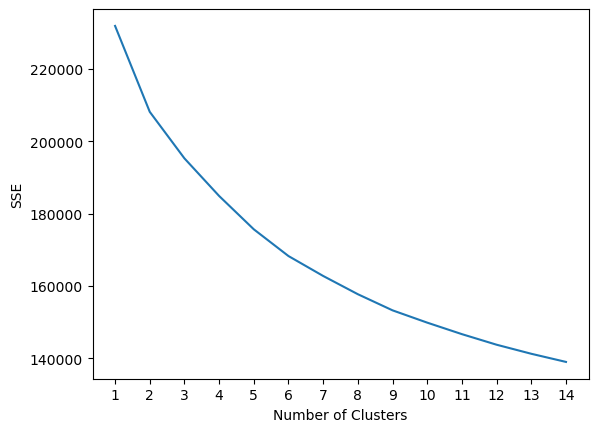

In [19]:
kmeans_kwargs = {'init': 'random',
                 'n_init': 10,
                 'max_iter': 300,
                 'random_state': 42}

sse = []
for k in range(1,15):
    kmeans = KMeans(n_clusters=k, **kmeans_kwargs)
    kmeans.fit(standardized)
    sse.append(kmeans.inertia_)

plt.plot(range(1,15), sse)
plt.xticks(range(1,15))
plt.xlabel('Number of Clusters')
plt.ylabel('SSE')
plt.show()

In [20]:
from kneed import KneeLocator

kl = KneeLocator(range(1,15), sse, curve='convex', direction='decreasing')
kl.elbow

6

--------------------------------------

Na osnovu lakta krive, moze se zakljuciti da je optimalan broj klastera 6, sto je i ocekivano s obzirom da postoji 6 labela.

---------------------

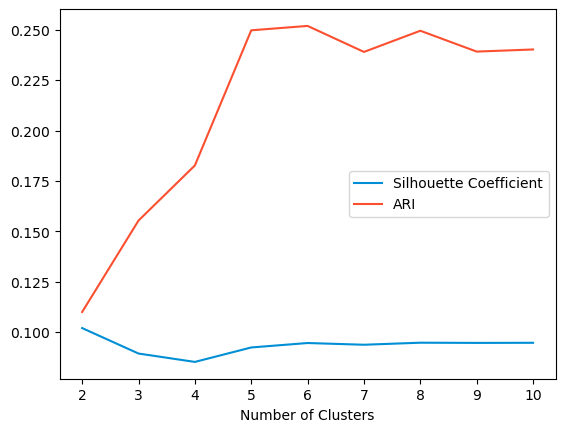

In [22]:
from sklearn.metrics import silhouette_score, adjusted_rand_score

silhouette_coefficients = []
ari_scores = []
for k in range(2,11):
    kmeans = KMeans(n_clusters=k, **kmeans_kwargs)
    kmeans.fit(standardized)
    score = silhouette_score(standardized, kmeans.labels_)
    silhouette_coefficients.append(score)
    ari = adjusted_rand_score(true_labels, kmeans.labels_)
    ari_scores.append(ari)

plt.plot(range(2,11), silhouette_coefficients, c="#008fd5", label="Silhouette Coefficient")
plt.plot(range(2,11), ari_scores, c="#fc4f30", label="ARI")
plt.xticks(range(2,11))
plt.xlabel('Number of Clusters')
plt.legend()
plt.show()

In [161]:
from sklearn.decomposition import PCA
import plotly as py
import plotly.graph_objs as go
from plotly.offline import download_plotlyjs, init_notebook_mode, plot, iplot

kmeans = KMeans(init='random', n_clusters=6, n_init=10, max_iter=300, random_state=42)
kmeans.fit(standardized)
predicted_clusters = kmeans.predict(standardized)

pca_1d = PCA(n_components=1)
pca_2d = PCA(n_components=2)
pca_3d = PCA(n_components=3)

PCs_1d = pd.DataFrame(pca_1d.fit_transform(standardized))
PCs_2d = pd.DataFrame(pca_2d.fit_transform(standardized))
PCs_3d = pd.DataFrame(pca_3d.fit_transform(standardized))

PCs_1d.columns = ["PC1_1d"]
PCs_2d.columns = ["PC1_2d", "PC2_2d"]
PCs_3d.columns = ["PC1_3d", "PC2_3d", "PC3_3d"]

dataframe['Predicted_Cluster'] = predicted_clusters
# dataframe['Predicted_Cluster'] = true_labels
plotX = pd.concat([dataframe,PCs_3d], axis=1, join='inner')
plotX["dummy"] = 0

cluster0 = plotX[plotX["Predicted_Cluster"] == 0]
cluster1 = plotX[plotX["Predicted_Cluster"] == 1]
cluster2 = plotX[plotX["Predicted_Cluster"] == 2]
cluster3 = plotX[plotX["Predicted_Cluster"] == 3]
cluster4 = plotX[plotX["Predicted_Cluster"] == 4]
cluster5 = plotX[plotX["Predicted_Cluster"] == 5]

init_notebook_mode(connected=True)

In [20]:
trace1 = go.Scatter3d(x = cluster0["PC1_3d"],
                    y = cluster0["PC2_3d"],
                    z = cluster0["PC3_3d"],
                    mode = "markers",
                    name = "Cluster 0",
                    marker = dict(color = 'rgba(255, 128, 255, 0.8)'),
                    text = None)
trace2 = go.Scatter3d(x = cluster1["PC1_3d"],
                    y = cluster1["PC2_3d"],
                    z = cluster1["PC3_3d"],
                    mode = "markers",
                    name = "Cluster 1",
                    marker = dict(color = 'rgba(255, 128, 2, 0.8)'),
                    text = None)
trace3 = go.Scatter3d(x = cluster2["PC1_3d"],
                    y = cluster2["PC2_3d"],
                    z = cluster2["PC3_3d"],
                    mode = "markers",
                    name = "Cluster 2",
                    marker = dict(color = 'rgba(0, 255, 200, 0.8)'),
                    text = None)
trace4 = go.Scatter3d(x = cluster3["PC1_3d"],
                    y = cluster3["PC2_3d"],
                    z = cluster3["PC3_3d"],
                    mode = "markers",
                    name = "Cluster 3",
                    marker = dict(color = 'rgba(255, 255, 0, 0.8)'),
                    text = None)
trace5 = go.Scatter3d(x = cluster4["PC1_3d"],
                    y = cluster4["PC2_3d"],
                    z = cluster4["PC3_3d"],
                    mode = "markers",
                    name = "Cluster 4",
                    marker = dict(color = 'rgba(0, 128, 2, 0.8)'),
                    text = None)
trace6 = go.Scatter3d(x = cluster5["PC1_3d"],
                    y = cluster5["PC2_3d"],
                    z = cluster5["PC3_3d"],
                    mode = "markers",
                    name = "Cluster 5",
                    marker = dict(color = 'rgba(0, 0, 255, 0.8)'),
                    text = None)

# data = [trace1, trace2, trace3, trace4, trace5, trace6]
data = [trace6, trace5, trace4, trace3, trace2, trace1]
# data = [trace1, trace2, trace3]
title = "Visualizing Clusters in Three Dimensions Using PCA"
layout = dict(title = title,
              xaxis= dict(title= 'PC1',ticklen= 10,zeroline= False),
              yaxis= dict(title= 'PC2',ticklen= 10,zeroline= False)
             )

fig = dict(data = data, layout = layout)

iplot(fig)

--------------------------------------

Vec ovde mozemo zakljuciti da su nasi podaci dosta gusto rasporedjeni i da predvidjeni klasteri nisu jasno razdvojeni.

---------------------

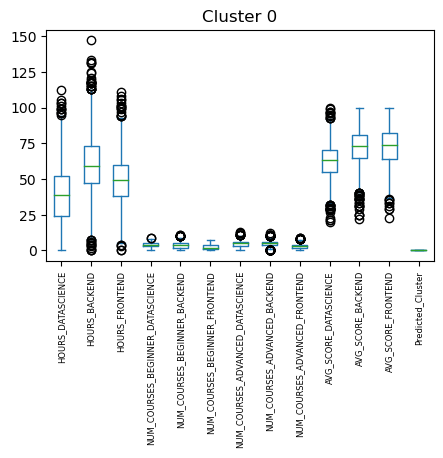

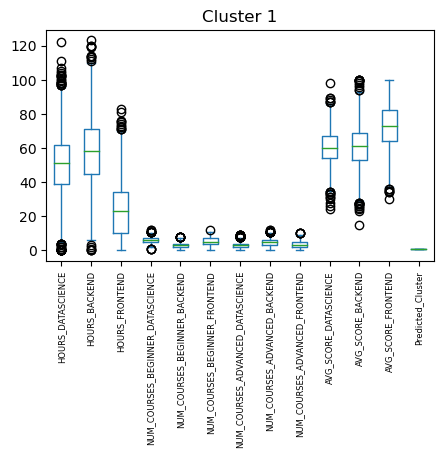

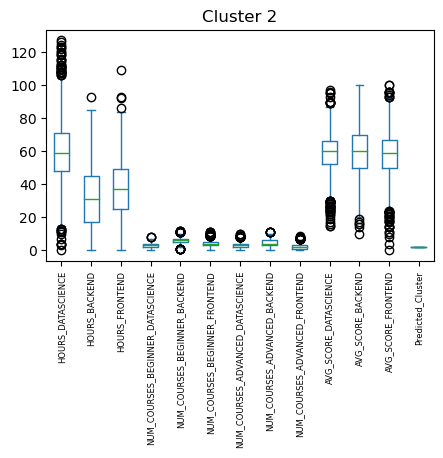

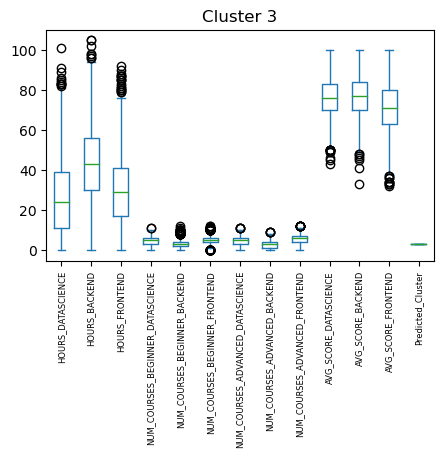

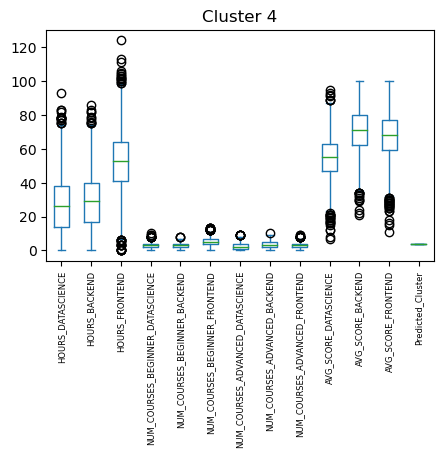

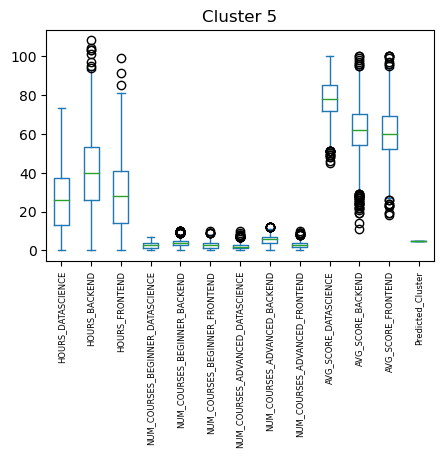

In [47]:
for i in range(6):
    dataframe[dataframe['Predicted_Cluster'] == i].plot(kind='box', figsize=(5,3))
    plt.title("Cluster {}".format(i))
    plt.xticks(rotation=90, fontsize=6)
    plt.show()

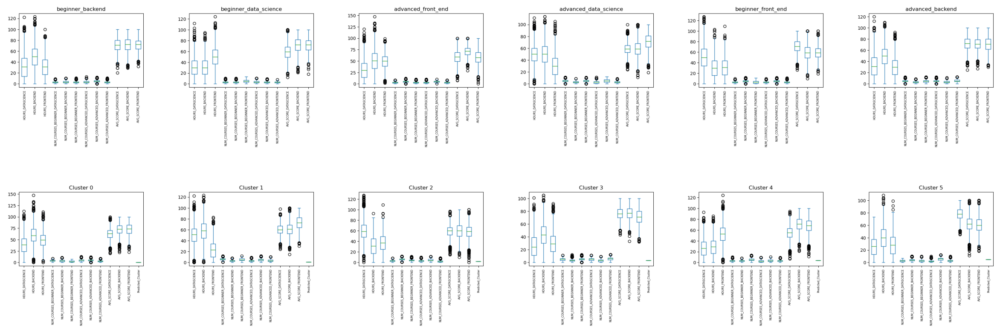

In [204]:
from PIL import Image

# img = Image.open("cluster_boxplots/c00.png")
# img

fig, ax = plt.subplots(2,6, figsize=(30,10))
for i in range(6):
    with open("cluster_boxplots/c0{}.png".format(i),'rb') as f:
        image = Image.open(f)
        ax[0][i].imshow(image)
        ax[0][i].set_axis_off()
    with open("cluster_boxplots/c1{}.png".format(i),'rb') as f:
        image = Image.open(f)
        ax[1][i].imshow(image)
        ax[1][i].set_axis_off()

--------------------------------------

Dobijeni klasteri slabo odgovaraju bilo kojoj od labela, prema ovim boxplot-ovima.

---------------------

	       hours       num_of_courses       scores                 true_labels
	    DS  FE  BE    DS FE BE DS FE BE   DS  FE  BE      a_BE a_DS a_FE b_BE b_DS b_FE
	    -------------------------------------------------------------------------------
Cluster 0: [39. 59. 49.] [4. 4. 2. 5. 5. 3.] [63. 73. 74.] - [ 495  307 1336  838  475   86]
Cluster 1: [51. 58. 23.] [6. 3. 5. 3. 5. 3.] [60. 61. 73.] - [ 629 1895   16  404   72   34]
Cluster 2: [59. 31. 37.] [3. 6. 4. 3. 4. 2.] [60. 60. 59.] - [ 111  445  916   27  157 1582]
Cluster 3: [24. 43. 29.] [5. 3. 5. 5. 3. 6.] [76. 77. 71.] - [2010    9   46  502  238  154]
Cluster 4: [26. 29. 53.] [3. 3. 5. 2. 3. 3.] [55. 71. 68.] - [  13  335  666  153 2090   39]
Cluster 5: [26. 40. 28.] [3. 4. 3. 2. 6. 3.] [78. 62. 60.] - [   5  259  264 1223  183 1314]


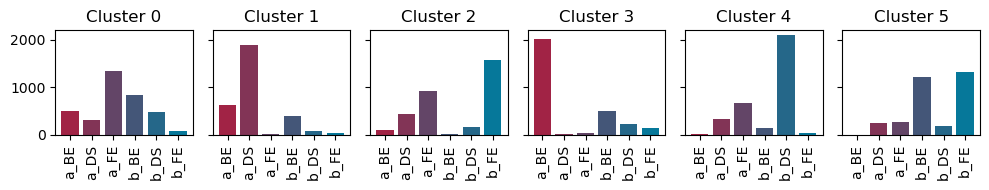

In [162]:
print("\t       hours       num_of_courses       scores                 true_labels")
print("\t    DS  FE  BE    DS FE BE DS FE BE   DS  FE  BE      a_BE a_DS a_FE b_BE b_DS b_FE")
print("\t    -------------------------------------------------------------------------------")

fig, ax = plt.subplots(1,6, sharey=True, tight_layout=True, figsize=(10,2))

for i in range(6):
    indices = dataframe.index[dataframe['Predicted_Cluster'] == i].to_list()
    labels, counts = np.unique(true_labels[indices], return_counts=True)
    hours = dataframe[dataframe['Predicted_Cluster'] == i].iloc[:,0:3].median().to_numpy()
    courses = dataframe[dataframe['Predicted_Cluster'] == i].iloc[:,3:9].median().to_numpy()
    scores = dataframe[dataframe['Predicted_Cluster'] == i].iloc[:,9:12].median().to_numpy()
    
    modified_counts = counts[0:3] + counts[3:6]
    
    print("Cluster {}: {} {} {} - {}".format(i, hours, courses, scores, counts))
    
    ax[i].bar(range(6), counts, color=['#a12345', '#823456', '#634567', '#445678', '#256789', '#06789a'])
    ax[i].set_xticks(range(6), labels=["a_BE", "a_DS", "a_FE", "b_BE", "b_DS", "b_FE"], rotation=90)
    ax[i].set_title("Cluster {}".format(i))

--------------------------------------

U tabeli iznad prikazane su median vrednosti svih feature-a, za svaki od dobijenih klastera, kao i broj instanci koje pripadaju svakoj od ground truth labela(to je predstavljeno graficki na dijagramima ispod). Na taj nacin mozemo dodeliti svakom od klastera onu ground truth labelu koja ima najvise instanci. Jedini problem je kod klastera 5, kod koga je potrebno dodeliti jedinu preostalu labelu beginner_backend. Medjutim, ima vise instani kod beginner_front_end, zbog toga sto su ta dva klastera jako blizu (sto se moze videti i na 3d dijagramu). Takodje, analizom vrednosti feature-a, zakljuceno je da je podela veoma neinutitivna u odnosu na labele.

---------------------

In [227]:
print("\t          hours                num_of_courses                 scores      ")
print("\t      DS    FE    BE    b_DS b_FE b_BE a_DS a_FE a_BE     DS    FE    BE  ")
print("\t    -------------------------------------------------------------------------------")

for i in range(6):
    hours = dataframe[dataframe['Predicted_Cluster'] == i].iloc[:,0:3].mean().to_numpy()
    courses = dataframe[dataframe['Predicted_Cluster'] == i].iloc[:,3:9].mean().to_numpy()
    scores = dataframe[dataframe['Predicted_Cluster'] == i].iloc[:,9:12].mean().to_numpy()
    
    courses_mod = courses[0:3] + courses[3:6]
    
    print("Cluster {}: {} {} {}     {}".format(i, np.round(hours,2), np.round(courses,2), np.round(scores,2), np.round(courses_mod,2)))

	          hours                num_of_courses                 scores      
	      DS    FE    BE    b_DS b_FE b_BE a_DS a_FE a_BE     DS    FE    BE  
	    -------------------------------------------------------------------------------
Cluster 0: [37.56 60.22 49.33] [3.6  3.84 2.41 4.6  4.77 3.2 ] [62.87 72.72 73.  ]     [8.21 8.61 5.62]
Cluster 1: [50.61 58.14 23.14] [5.89 2.64 5.42 3.08 4.82 3.29] [60.25 60.87 72.84]     [8.97 7.46 8.71]
Cluster 2: [59.88 31.09 36.43] [3.09 5.8  4.05 3.32 4.52 2.43] [58.78 60.15 58.25]     [ 6.41 10.32  6.48]
Cluster 3: [25.86 43.21 29.53] [4.61 3.22 4.96 4.79 2.67 5.69] [76.54 77.33 71.32]     [ 9.4   5.89 10.65]
Cluster 4: [26.75 28.72 52.59] [2.87 2.68 5.17 2.39 3.42 3.23] [54.57 71.18 67.48]     [5.26 6.1  8.4 ]
Cluster 5: [25.36 39.61 28.13] [2.54 4.08 2.72 2.36 5.73 2.75] [78.13 61.63 60.48]     [4.9  9.82 5.47]


--------------------------------------

Analiza sa mean umesto median vrednostima, koja ne pokazuje nista znacajnije.

---------------------

In [27]:
from sklearn import metrics

print(' rand score:',metrics.rand_score(true_labels, kmeans.labels_),'\n',
     'ajusted rand score:',metrics.adjusted_rand_score(true_labels, kmeans.labels_),'\n',
     'ajusted mutual info score:',metrics.adjusted_mutual_info_score(true_labels, kmeans.labels_),'\n',
      'silhouette score:',metrics.silhouette_score(standardized, kmeans.labels_))

 rand score: 0.7919496275241341 
 ajusted rand score: 0.2518884878333557 
 ajusted mutual info score: 0.3184313784028749 
 silhouette score: 0.09455397615445162


**2. Agglomerative:**

In [21]:
from sklearn.cluster import AgglomerativeClustering


ac= AgglomerativeClustering(n_clusters=6, affinity='euclidean', linkage='ward')
ac.fit(standardized)
ac.labels_

array([2, 1, 3, ..., 0, 3, 1], dtype=int64)

Analiza:

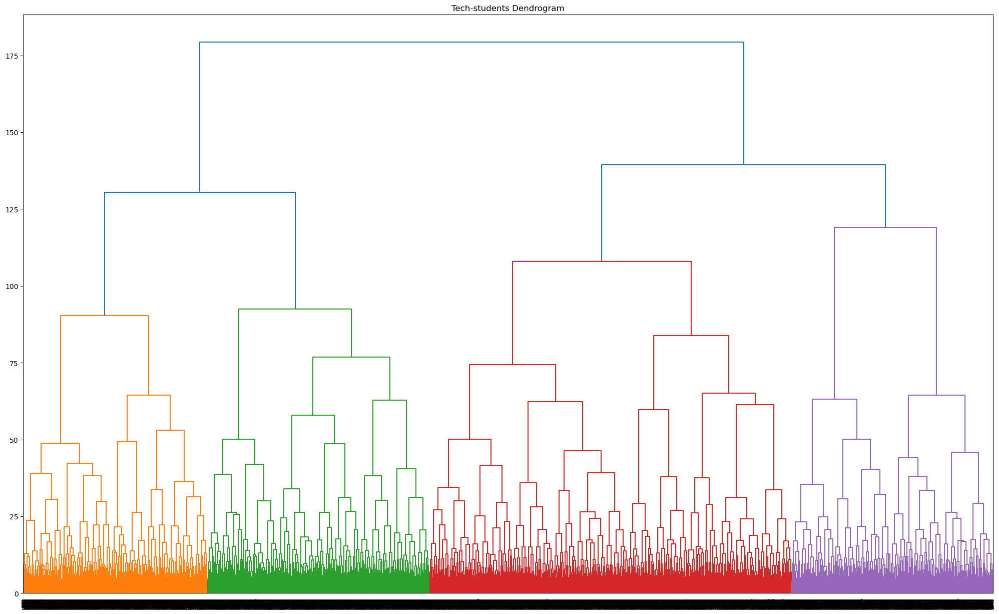

In [34]:
import scipy.cluster.hierarchy as shc
import matplotlib.pyplot as plt

plt.figure(figsize=(25, 15))
plt.title("Tech-students Dendrogram")
clusters = shc.linkage(standardized, 
            method='ward', 
            metric="euclidean")
shc.dendrogram(Z=clusters)
plt.show()

---------------------

Vec se po dendrogramu vidi da dataset ne moze da se efikasno podeli po 6 klastera. Nadalje su izvrsene analize i po 6 i po 2 klastera (najbolja podela po dendrogramu).

---------------------

In [22]:
dataframe.drop(['Predicted_Cluster'], axis=1)
predicted_clusters=ac.labels_
from sklearn.decomposition import PCA
import plotly as py
import plotly.graph_objs as go
from plotly.offline import download_plotlyjs, init_notebook_mode, plot, iplot

pca_1d = PCA(n_components=1)
pca_2d = PCA(n_components=2)
pca_3d = PCA(n_components=3)

PCs_1d = pd.DataFrame(pca_1d.fit_transform(standardized))
PCs_2d = pd.DataFrame(pca_2d.fit_transform(standardized))
PCs_3d = pd.DataFrame(pca_3d.fit_transform(standardized))

PCs_1d.columns = ["PC1_1d"]
PCs_2d.columns = ["PC1_2d", "PC2_2d"]
PCs_3d.columns = ["PC1_3d", "PC2_3d", "PC3_3d"]

dataframe['Predicted_Cluster'] = predicted_clusters
# dataframe['Predicted_Cluster'] = true_labels
plotX = pd.concat([dataframe,PCs_3d], axis=1, join='inner')
plotX["dummy"] = 0

cluster0 = plotX[plotX["Predicted_Cluster"] == 0]
cluster1 = plotX[plotX["Predicted_Cluster"] == 1]
cluster2 = plotX[plotX["Predicted_Cluster"] == 2]
cluster3 = plotX[plotX["Predicted_Cluster"] == 3]
cluster4 = plotX[plotX["Predicted_Cluster"] == 4]
cluster5 = plotX[plotX["Predicted_Cluster"] == 5]

init_notebook_mode(connected=True)

In [23]:
trace1 = go.Scatter3d(x = cluster0["PC1_3d"],
                    y = cluster0["PC2_3d"],
                    z = cluster0["PC3_3d"],
                    mode = "markers",
                    name = "Cluster 0",
                    marker = dict(color = 'rgba(255, 128, 255, 0.8)'),
                    text = None)
trace2 = go.Scatter3d(x = cluster1["PC1_3d"],
                    y = cluster1["PC2_3d"],
                    z = cluster1["PC3_3d"],
                    mode = "markers",
                    name = "Cluster 1",
                    marker = dict(color = 'rgba(255, 128, 2, 0.8)'),
                    text = None)
trace3 = go.Scatter3d(x = cluster2["PC1_3d"],
                    y = cluster2["PC2_3d"],
                    z = cluster2["PC3_3d"],
                    mode = "markers",
                    name = "Cluster 2",
                    marker = dict(color = 'rgba(0, 255, 200, 0.8)'),
                    text = None)
trace4 = go.Scatter3d(x = cluster3["PC1_3d"],
                    y = cluster3["PC2_3d"],
                    z = cluster3["PC3_3d"],
                    mode = "markers",
                    name = "Cluster 3",
                    marker = dict(color = 'rgba(255, 255, 0, 0.8)'),
                    text = None)
trace5 = go.Scatter3d(x = cluster4["PC1_3d"],
                    y = cluster4["PC2_3d"],
                    z = cluster4["PC3_3d"],
                    mode = "markers",
                    name = "Cluster 4",
                    marker = dict(color = 'rgba(0, 128, 2, 0.8)'),
                    text = None)
trace6 = go.Scatter3d(x = cluster5["PC1_3d"],
                    y = cluster5["PC2_3d"],
                    z = cluster5["PC3_3d"],
                    mode = "markers",
                    name = "Cluster 5",
                    marker = dict(color = 'rgba(0, 0, 255, 0.8)'),
                    text = None)

# data = [trace1, trace2, trace3, trace4, trace5, trace6]
data = [trace6, trace5, trace4, trace3, trace2, trace1]
# data = [trace1, trace2, trace3]
title = "Visualizing Clusters in Three Dimensions Using PCA"
layout = dict(title = title,
              xaxis= dict(title= 'PC1',ticklen= 10,zeroline= False),
              yaxis= dict(title= 'PC2',ticklen= 10,zeroline= False)
             )

fig = dict(data = data, layout = layout)

iplot(fig)

In [122]:
from tabulate import tabulate
dataframe['PROFILE']=dataframe_profiles
dataframe['Predicted_Cluster']=ac.labels_
table=[]
table.append(['abe','ads','afe','bbe','bds','bfe'])
for i in range(0, 6):
    table.append(dataframe.where(dataframe['Predicted_Cluster']==i)['PROFILE'].value_counts().sort_index().tolist())
dataframe.drop(['PROFILE'], axis=1)
dataframe.drop(['Predicted_Cluster'], axis=1)
print(tabulate(table, headers='firstrow', tablefmt='fancy_grid'))

╒═══════╤═══════╤═══════╤═══════╤═══════╤═══════╕
│   abe │   ads │   afe │   bbe │   bds │   bfe │
╞═══════╪═══════╪═══════╪═══════╪═══════╪═══════╡
│  2945 │    93 │   106 │  1123 │    88 │    70 │
├───────┼───────┼───────┼───────┼───────┼───────┤
│   140 │   874 │    27 │    81 │  2534 │    21 │
├───────┼───────┼───────┼───────┼───────┼───────┤
│    18 │   202 │   482 │  1574 │   292 │  1391 │
├───────┼───────┼───────┼───────┼───────┼───────┤
│    43 │   277 │  2526 │    61 │   240 │   110 │
├───────┼───────┼───────┼───────┼───────┼───────┤
│    31 │   198 │    94 │    21 │    52 │  1583 │
├───────┼───────┼───────┼───────┼───────┼───────┤
│    86 │  1606 │     9 │   287 │     9 │    34 │
╘═══════╧═══════╧═══════╧═══════╧═══════╧═══════╛


--------------------------------------

Kreirani klasteri samo delimicno odgovaraju labelama profila. Iako se vidi da za svaki klaster prednjaci razlicita labela profila, ta prednost je nedovoljno izrazena da bi ovaj nacin klasterizacije bio proglasen uspesnim.

---------------------

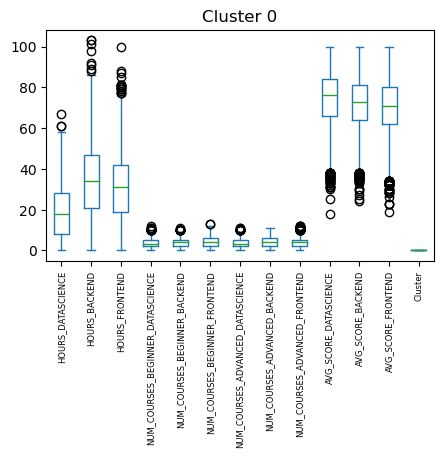

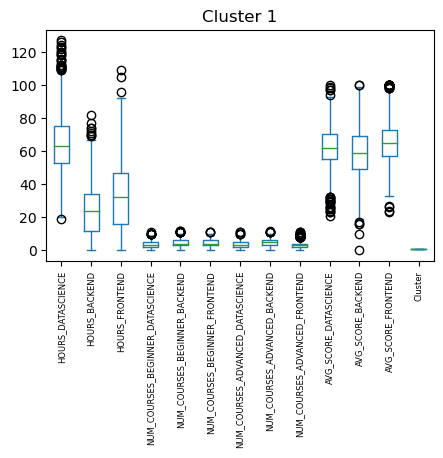

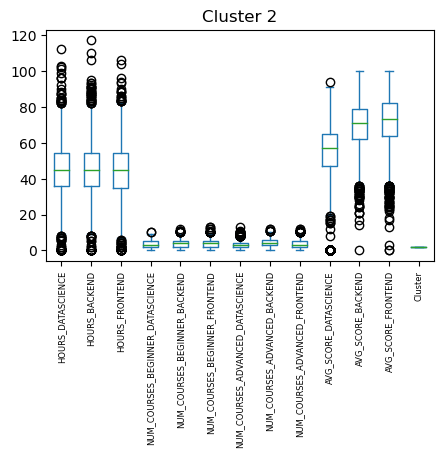

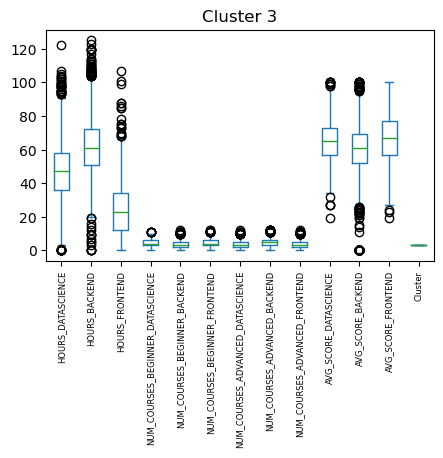

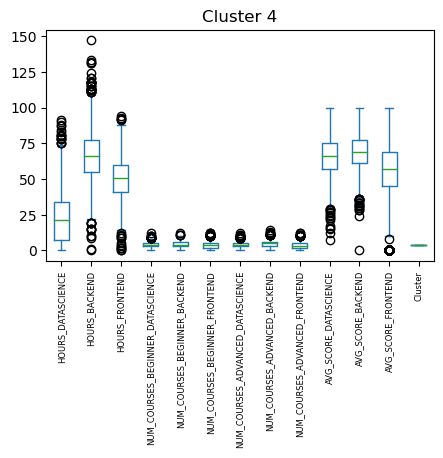

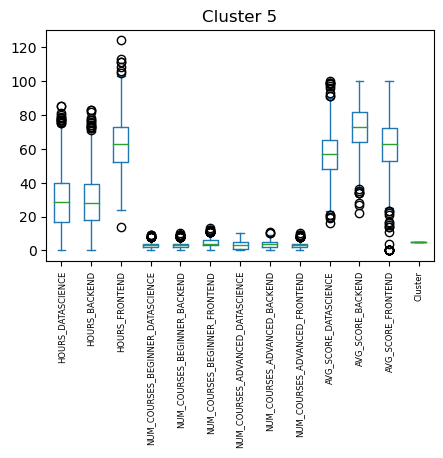

In [43]:
dataframe['Predicted_Cluster']=ac.labels_
for i in range(6):
    dataframe[dataframe['Predicted_Cluster'] == i].plot(kind='box', figsize=(5,3))
    plt.title("Cluster {}".format(i))
    plt.xticks(rotation=90, fontsize=6)
    plt.show()
dataframe.drop(['Predicted_Cluster'], axis=1)

In [26]:
from sklearn import metrics

print(' rand score:',metrics.rand_score(true_labels, ac.labels_),'\n',
     'ajusted rand score:',metrics.adjusted_rand_score(true_labels, ac.labels_),'\n',
     'ajusted mutual info score:',metrics.adjusted_mutual_info_score(true_labels, ac.labels_),'\n',
      'silhouette score:',metrics.silhouette_score(standardized, ac.labels_))

 rand score: 0.8332963889261051 
 ajusted rand score: 0.4190484427815838 
 ajusted mutual info score: 0.4734969908724102 
 silhouette score: 0.05172388939029994


--------------------------------------

Rezultati nisu dovoljno dobri.

---------------------

Sa 2 klastera (po dendrogramu):

In [107]:
from sklearn.cluster import AgglomerativeClustering


ac2= AgglomerativeClustering(n_clusters=2, affinity='euclidean', linkage='ward')
ac2.fit(standardized)
ac2.labels_

array([0, 1, 0, ..., 1, 0, 1], dtype=int64)

In [115]:
dataframe.drop(['Predicted_Cluster'], axis=1)
predicted_clusters=ac2.labels_
from sklearn.decomposition import PCA
import plotly as py
import plotly.graph_objs as go
from plotly.offline import download_plotlyjs, init_notebook_mode, plot, iplot

pca_1d = PCA(n_components=1)
pca_2d = PCA(n_components=2)
pca_3d = PCA(n_components=3)

PCs_1d = pd.DataFrame(pca_1d.fit_transform(standardized))
PCs_2d = pd.DataFrame(pca_2d.fit_transform(standardized))
PCs_3d = pd.DataFrame(pca_3d.fit_transform(standardized))

PCs_1d.columns = ["PC1_1d"]
PCs_2d.columns = ["PC1_2d", "PC2_2d"]
PCs_3d.columns = ["PC1_3d", "PC2_3d", "PC3_3d"]

dataframe['Predicted_Cluster'] = predicted_clusters
# dataframe['Predicted_Cluster'] = true_labels
plotX = pd.concat([dataframe,PCs_3d], axis=1, join='inner')
plotX["dummy"] = 0

cluster0 = plotX[plotX["Predicted_Cluster"] == 0]
cluster1 = plotX[plotX["Predicted_Cluster"] == 1]
init_notebook_mode(connected=True)

In [116]:
trace1 = go.Scatter3d(x = cluster0["PC1_3d"],
                    y = cluster0["PC2_3d"],
                    z = cluster0["PC3_3d"],
                    mode = "markers",
                    name = "Cluster 0",
                    marker = dict(color = 'rgba(255, 128, 255, 0.8)'),
                    text = None)
trace2 = go.Scatter3d(x = cluster1["PC1_3d"],
                    y = cluster1["PC2_3d"],
                    z = cluster1["PC3_3d"],
                    mode = "markers",
                    name = "Cluster 1",
                    marker = dict(color = 'rgba(255, 128, 2, 0.8)'),
                    text = None)


data = [trace2, trace1]
title = "Visualizing Clusters in Three Dimensions Using PCA"
layout = dict(title = title,
              xaxis= dict(title= 'PC1',ticklen= 10,zeroline= False),
              yaxis= dict(title= 'PC2',ticklen= 10,zeroline= False)
             )

fig = dict(data = data, layout = layout)

iplot(fig)

In [123]:
from tabulate import tabulate
dataframe['PROFILE']=dataframe_profiles
dataframe['Predicted_Cluster']=ac2.labels_
dataframe.drop(['PROFILE'], axis=1)
dataframe.drop(['Predicted_Cluster'], axis=1)
print(dataframe.groupby('Predicted_Cluster')['PROFILE'].value_counts())

Predicted_Cluster  PROFILE              
0                  beginner_front_end       3118
                   advanced_front_end       3111
                   advanced_data_science    2283
                   beginner_backend         1943
                   beginner_data_science     593
                   advanced_backend          178
1                  advanced_backend         3085
                   beginner_data_science    2622
                   beginner_backend         1204
                   advanced_data_science     967
                   advanced_front_end        133
                   beginner_front_end         91
Name: PROFILE, dtype: int64


--------------------------------------

Podela je i ovde prilicno losa i neintuitivna.

---------------------

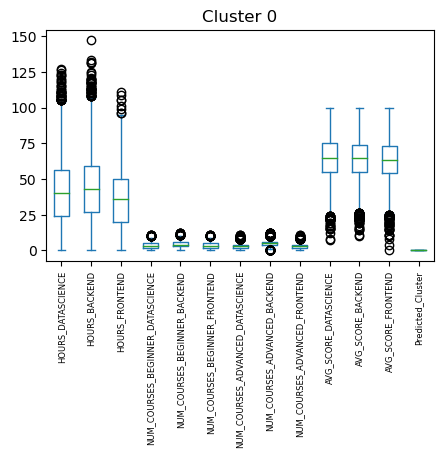

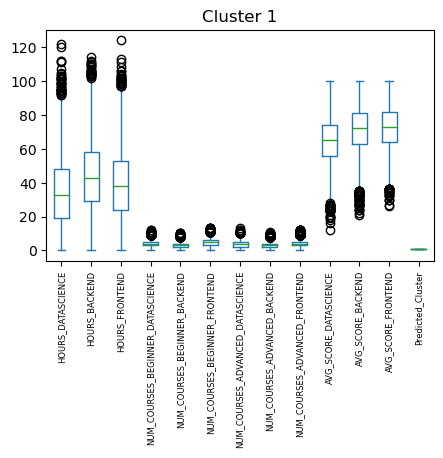

In [124]:
dataframe['Predicted_Cluster']=ac2.labels_
for i in range(2):
    dataframe[dataframe['Predicted_Cluster'] == i].plot(kind='box', figsize=(5,3))
    plt.title("Cluster {}".format(i))
    plt.xticks(rotation=90, fontsize=6)
    plt.show()
dataframe=dataframe.drop(['Predicted_Cluster'], axis=1)

--------------------------------------

Analiza feature-a je i ovde pokazala da su klasteri nedovoljno jasno odvojeni.

---------------------

**3. MeanShift**

In [33]:
from sklearn.cluster import MeanShift

meanshift = MeanShift()
meanshift.fit(standardized)
meanshift.n_iter_, meanshift.labels_[:5]

(6, array([0, 0, 0, 0, 0], dtype=int64))

In [34]:
np.unique(meanshift.labels_)

array([0], dtype=int64)

In [36]:
from sklearn import metrics

print(' rand score:',metrics.rand_score(true_labels, meanshift.labels_),'\n',
     'ajusted rand score:',metrics.adjusted_rand_score(true_labels, meanshift.labels_),'\n',
     'ajusted mutual info score:',metrics.adjusted_mutual_info_score(true_labels, meanshift.labels_),'\n',
     )

 rand score: 0.16664707815337088 
 ajusted rand score: 0.0 
 ajusted mutual info score: -1.251614496997333e-17 



**4. DBSCAN**

In [37]:
from sklearn.cluster import DBSCAN

dbscan = DBSCAN(eps=2.5, min_samples=24)  #min_samples se obicno postavlja na 2*broj_featurea
dbscan.fit(standardized)
# dbscan.fit(dataframe.to_numpy())
dbscan.labels_

array([0, 0, 0, ..., 0, 0, 0], dtype=int64)

In [ ]:
dataframe.drop('Predicted_Cluster', axis=1, inplace=True)

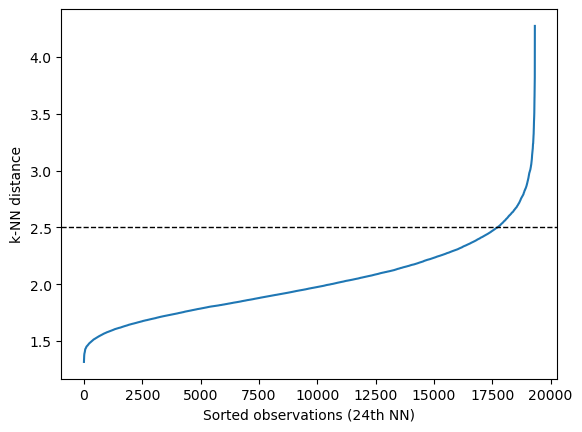

In [33]:
from sklearn.neighbors import NearestNeighbors

nbrs = NearestNeighbors(n_neighbors=25).fit(standardized)  #24+1
neigh_dist, neigh_ind = nbrs.kneighbors(standardized)
sort_neigh_dist = np.sort(neigh_dist, axis=0)

k_dist = sort_neigh_dist[:, 24]
plt.plot(k_dist)
plt.axhline(y=2.5, linewidth=1, linestyle='dashed', color='k')
plt.ylabel("k-NN distance")
plt.xlabel("Sorted observations (24th NN)")
plt.show()

--------------------------------------

MeanShift i DBSCAN su algoritmi bazirani na gustini i rade ocekivano lose na nasim gusto zbijenim podacima. Kao rezultat, sve ih smestaju u jedan klaster sa malim brojem tacaka koje se gledaju kao sumovi.

---------------------

**5. BIRCH**

In [57]:
from sklearn.cluster import Birch

birch = Birch(n_clusters=6)
birch.fit(standardized)
birch.labels_

array([5, 0, 4, ..., 1, 4, 2], dtype=int64)

In [58]:
birch.labels_[:10], true_labels[:10]

(array([5, 0, 4, 5, 1, 1, 1, 0, 1, 0], dtype=int64),
 array([3, 4, 2, 1, 2, 3, 2, 3, 5, 5]))

In [60]:
from sklearn import metrics

print(' rand score:',metrics.rand_score(true_labels, birch.labels_),'\n',
     'ajusted rand score:',metrics.adjusted_rand_score(true_labels, birch.labels_),'\n',
     'ajusted mutual info score:',metrics.adjusted_mutual_info_score(true_labels, birch.labels_),'\n',
      'silhouette score', metrics.silhouette_score(standardized, birch.labels_)
     )

 rand score: 0.781070014472085 
 ajusted rand score: 0.2453570783277494 
 ajusted mutual info score: 0.34387760082665186 
 silhouette score 0.03657131665537166


**6. Spectral Clustering**

Izvrsena je klasterizacija kada je affinity rbf kernel i kada je affinity Euklidska distanca.

---------------------

Affinity je RBF kernel:

In [62]:
from sklearn.cluster import SpectralClustering 

sc= SpectralClustering(n_clusters = 6, affinity ='rbf')
sc.fit(standardized)
sc.labels_

array([0, 5, 0, ..., 0, 0, 4])

In [121]:
from tabulate import tabulate
dataframe['PROFILE']=dataframe_profiles
dataframe['Predicted_Cluster']=sc.labels_
table=[]
table.append(['abe','ads','afe','bbe','bds','bfe'])
for i in range(0, 6):
    table.append(dataframe.where(dataframe['Predicted_Cluster']==i)['PROFILE'].value_counts().sort_index().tolist())
dataframe.drop(['PROFILE'], axis=1)
dataframe.drop(['Predicted_Cluster'], axis=1)
print(tabulate(table, headers='firstrow', tablefmt='fancy_grid'))

╒═══════╤═══════╤═══════╤═══════╤═══════╤═══════╕
│   abe │   ads │   afe │   bbe │   bds │   bfe │
╞═══════╪═══════╪═══════╪═══════╪═══════╪═══════╡
│   401 │   733 │  3222 │  2309 │   759 │  3171 │
├───────┼───────┼───────┼───────┼───────┼───────┤
│     2 │       │       │       │       │       │
├───────┼───────┼───────┼───────┼───────┼───────┤
│     2 │       │       │       │       │       │
├───────┼───────┼───────┼───────┼───────┼───────┤
│  2480 │     2 │     6 │   206 │    21 │    14 │
├───────┼───────┼───────┼───────┼───────┼───────┤
│   376 │  2443 │    10 │   568 │    20 │    15 │
├───────┼───────┼───────┼───────┼───────┼───────┤
│     6 │    70 │     6 │    64 │  2413 │     9 │
╘═══════╧═══════╧═══════╧═══════╧═══════╧═══════╛


--------------------------------------

Podela je prilicno losa.

---------------------

In [118]:
from sklearn import metrics

print(' rand score:',metrics.rand_score(true_labels, sc.labels_),'\n',
     'ajusted rand score:',metrics.adjusted_rand_score(true_labels, sc.labels_),'\n',
     'ajusted mutual info score:',metrics.adjusted_mutual_info_score(true_labels, sc.labels_),'\n',
      'silhouette score', metrics.silhouette_score(standardized, sc.labels_)
     )

 rand score: 0.7072841610679498 
 ajusted rand score: 0.29132141631836034 
 ajusted mutual info score: 0.46918812494473794 
 silhouette score 0.06112075764930179


---------------------

Affinity je Euklidska distanca:

In [165]:
from sklearn.cluster import SpectralClustering 

scnn= SpectralClustering(n_clusters = 6, affinity ='nearest_neighbors')
scnn.fit(standardized)
scnn.labels_

array([1, 3, 0, ..., 2, 0, 4])

In [166]:
from tabulate import tabulate
dataframe['PROFILE']=dataframe_profiles
dataframe['Predicted_Cluster']=scnn.labels_
table=[]
table.append(['abe','ads','afe','bbe','bds','bfe'])
for i in range(0, 6):
    table.append(dataframe.where(dataframe['Predicted_Cluster']==i)['PROFILE'].value_counts().sort_index().tolist())
dataframe.drop(['PROFILE'], axis=1)
dataframe.drop(['Predicted_Cluster'], axis=1)
print(tabulate(table, headers='firstrow', tablefmt='fancy_grid'))

╒═══════╤═══════╤═══════╤═══════╤═══════╤═══════╕
│   abe │   ads │   afe │   bbe │   bds │   bfe │
╞═══════╪═══════╪═══════╪═══════╪═══════╪═══════╡
│    33 │    90 │  3053 │    25 │    35 │    47 │
├───────┼───────┼───────┼───────┼───────┼───────┤
│    47 │    80 │    76 │  2828 │   114 │   989 │
├───────┼───────┼───────┼───────┼───────┼───────┤
│  2955 │    10 │    12 │   126 │    23 │    23 │
├───────┼───────┼───────┼───────┼───────┼───────┤
│     6 │    86 │    10 │    93 │  2997 │    21 │
├───────┼───────┼───────┼───────┼───────┼───────┤
│   200 │  2893 │    23 │    68 │    28 │    13 │
├───────┼───────┼───────┼───────┼───────┼───────┤
│    22 │    91 │    70 │     7 │    18 │  2116 │
╘═══════╧═══════╧═══════╧═══════╧═══════╧═══════╛


In [65]:
from sklearn import metrics

print(' rand score:',metrics.rand_score(true_labels, scnn.labels_),'\n',
     'ajusted rand score:',metrics.adjusted_rand_score(true_labels, scnn.labels_),'\n',
     'ajusted mutual info score:',metrics.adjusted_mutual_info_score(true_labels, scnn.labels_),'\n',
      'silhouette score', metrics.silhouette_score(standardized, scnn.labels_)
     )

 rand score: 0.9241913934525937 
 ajusted rand score: 0.7299915813766624 
 ajusted mutual info score: 0.7329439349009215 
 silhouette score 0.061626346092817745


--------------------------------------

Spectral Clustering sa affinity Euklidska distanca daje malo bolje rezultate od prethodnih algoritama, na tabeli se vidi slucaj kao kod Aglomertaivnog klasterovanja sa 6 klastera, gde za svaki klaster postoji razlicita labela koja prednjaci u odnosu na ostale. Ovo opravdava dalju analizu ovog algoritma.

---------------------

In [70]:
dataframe.drop(['Predicted_Cluster'], axis=1)
predicted_clusters=scnn.labels_
from sklearn.decomposition import PCA
import plotly as py
import plotly.graph_objs as go
from plotly.offline import download_plotlyjs, init_notebook_mode, plot, iplot

pca_1d = PCA(n_components=1)
pca_2d = PCA(n_components=2)
pca_3d = PCA(n_components=3)

PCs_1d = pd.DataFrame(pca_1d.fit_transform(standardized))
PCs_2d = pd.DataFrame(pca_2d.fit_transform(standardized))
PCs_3d = pd.DataFrame(pca_3d.fit_transform(standardized))

PCs_1d.columns = ["PC1_1d"]
PCs_2d.columns = ["PC1_2d", "PC2_2d"]
PCs_3d.columns = ["PC1_3d", "PC2_3d", "PC3_3d"]

dataframe['Predicted_Cluster'] = predicted_clusters
# dataframe['Predicted_Cluster'] = true_labels
plotX = pd.concat([dataframe,PCs_3d], axis=1, join='inner')
plotX["dummy"] = 0

cluster0 = plotX[plotX["Predicted_Cluster"] == 0]
cluster1 = plotX[plotX["Predicted_Cluster"] == 1]
cluster2 = plotX[plotX["Predicted_Cluster"] == 2]
cluster3 = plotX[plotX["Predicted_Cluster"] == 3]
cluster4 = plotX[plotX["Predicted_Cluster"] == 4]
cluster5 = plotX[plotX["Predicted_Cluster"] == 5]

init_notebook_mode(connected=True)

In [71]:
trace1 = go.Scatter3d(x = cluster0["PC1_3d"],
                    y = cluster0["PC2_3d"],
                    z = cluster0["PC3_3d"],
                    mode = "markers",
                    name = "Cluster 0",
                    marker = dict(color = 'rgba(255, 128, 255, 0.8)'),
                    text = None)
trace2 = go.Scatter3d(x = cluster1["PC1_3d"],
                    y = cluster1["PC2_3d"],
                    z = cluster1["PC3_3d"],
                    mode = "markers",
                    name = "Cluster 1",
                    marker = dict(color = 'rgba(255, 128, 2, 0.8)'),
                    text = None)
trace3 = go.Scatter3d(x = cluster2["PC1_3d"],
                    y = cluster2["PC2_3d"],
                    z = cluster2["PC3_3d"],
                    mode = "markers",
                    name = "Cluster 2",
                    marker = dict(color = 'rgba(0, 255, 200, 0.8)'),
                    text = None)
trace4 = go.Scatter3d(x = cluster3["PC1_3d"],
                    y = cluster3["PC2_3d"],
                    z = cluster3["PC3_3d"],
                    mode = "markers",
                    name = "Cluster 3",
                    marker = dict(color = 'rgba(255, 255, 0, 0.8)'),
                    text = None)
trace5 = go.Scatter3d(x = cluster4["PC1_3d"],
                    y = cluster4["PC2_3d"],
                    z = cluster4["PC3_3d"],
                    mode = "markers",
                    name = "Cluster 4",
                    marker = dict(color = 'rgba(0, 128, 2, 0.8)'),
                    text = None)
trace6 = go.Scatter3d(x = cluster5["PC1_3d"],
                    y = cluster5["PC2_3d"],
                    z = cluster5["PC3_3d"],
                    mode = "markers",
                    name = "Cluster 5",
                    marker = dict(color = 'rgba(0, 0, 255, 0.8)'),
                    text = None)

# data = [trace1, trace2, trace3, trace4, trace5, trace6]
data = [trace6, trace5, trace4, trace3, trace2, trace1]
# data = [trace1, trace2, trace3]
title = "Visualizing Clusters in Three Dimensions Using PCA"
layout = dict(title = title,
              xaxis= dict(title= 'PC1',ticklen= 10,zeroline= False),
              yaxis= dict(title= 'PC2',ticklen= 10,zeroline= False)
             )

fig = dict(data = data, layout = layout)

iplot(fig)

In [127]:
from tabulate import tabulate
dataframe['PROFILE']=dataframe_profiles
dataframe['Predicted_Cluster']=scnn.labels_
dataframe.drop(['PROFILE'], axis=1)
dataframe.drop(['Predicted_Cluster'], axis=1)
print(dataframe.groupby('Predicted_Cluster')['PROFILE'].value_counts())

Predicted_Cluster  PROFILE              
0                  advanced_front_end       3053
                   advanced_data_science      90
                   beginner_front_end         47
                   beginner_data_science      35
                   advanced_backend           33
                   beginner_backend           25
1                  advanced_backend         2955
                   beginner_backend          126
                   beginner_data_science      23
                   beginner_front_end         23
                   advanced_front_end         12
                   advanced_data_science      10
2                  beginner_backend         2827
                   beginner_front_end       1003
                   beginner_data_science     114
                   advanced_data_science      80
                   advanced_front_end         76
                   advanced_backend           47
3                  beginner_front_end       2102
                   advanced_

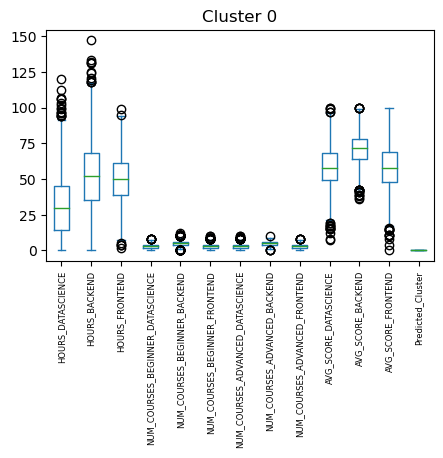

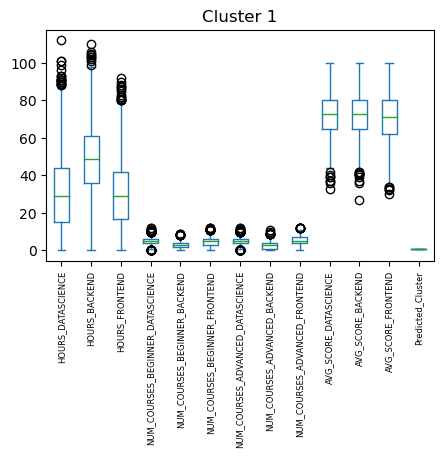

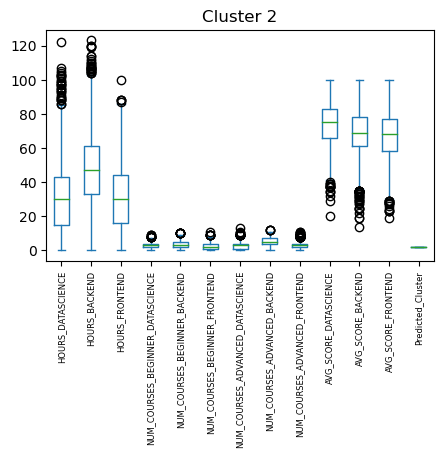

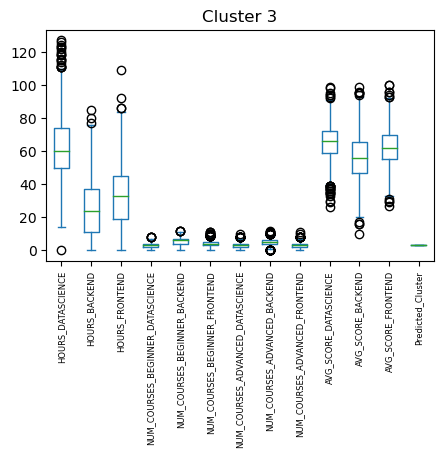

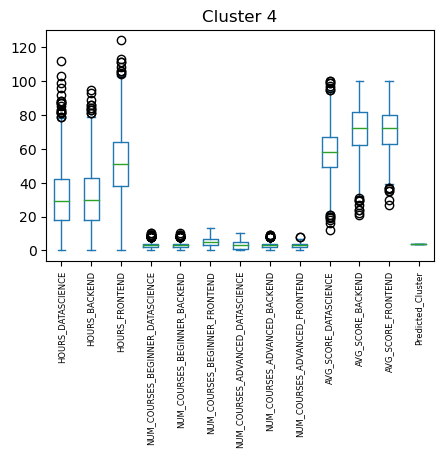

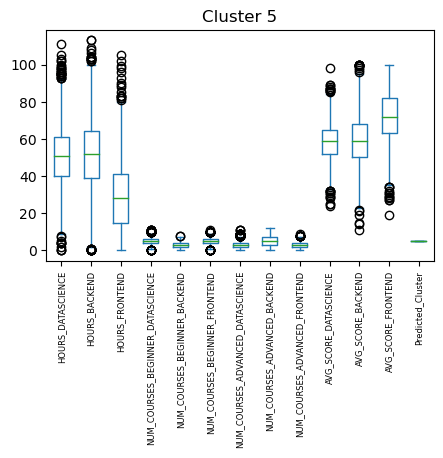

In [126]:
dataframe['Predicted_Cluster']=scnn.labels_
for i in range(6):
    dataframe[dataframe['Predicted_Cluster'] == i].plot(kind='box', figsize=(5,3))
    plt.title("Cluster {}".format(i))
    plt.xticks(rotation=90, fontsize=6)
    plt.show()
dataframe=dataframe.drop(['Predicted_Cluster'], axis=1)

--------------------------------------

Iako su ovde rezultati do sad najbolji, analiza feature-a po klasterima je pokazala da podela jos uvek nije dovoljno jasan, tj. ne zna se pravi kriterijum inicijalnog dodeljivanja labela. Ali buduci da je 70% instanci dobro dodeljeno (po Ajusted Rand Index Score-u), neki kriterijum ocigledno postoji, samo ga je tesko razumeti bez domenskog eksperta.

---------------------

**7. Affinity Propagation**

In [41]:
from sklearn.cluster import AffinityPropagation
af = AffinityPropagation(preference=-50)
af.fit(standardized)
af.labels_

array([178, 143, 263, ..., 148, 174, 115], dtype=int64)

In [42]:
silhouette_score(standardized, af.labels_)

0.06563070807294047

In [43]:
adjusted_rand_score(true_labels, af.labels_)

0.02106124421473517

**8. Gaussian Mixture**

In [130]:
from sklearn.mixture import GaussianMixture

g_mixture = GaussianMixture(n_components=6)
g_mixture.fit(standardized)
predictions = g_mixture.predict(standardized)

In [132]:
metrics.silhouette_score(standardized, predictions)

0.04516292483917351

In [134]:
metrics.adjusted_rand_score(true_labels, predictions)

0.9522232398443111

In [234]:
probabilities = g_mixture.predict_proba(standardized)
probabilities[:5].round(3)

array([[0.001, 0.   , 0.996, 0.   , 0.003, 0.   ],
       [0.   , 0.   , 0.   , 0.   , 1.   , 0.   ],
       [0.   , 0.   , 0.   , 0.   , 0.   , 1.   ],
       [1.   , 0.   , 0.   , 0.   , 0.   , 0.   ],
       [0.   , 0.   , 0.   , 0.   , 0.   , 1.   ]])

--------------------------------------

Vidimo da je ARI Score ovog algoritma 0.95, sto je odlican rezultat. Vrsi se dalja analiza rezultata ove klasterizacije, uz sumnju da se radi o overfit-u.

---------------------

Text(0.5, 0, 'n_components')

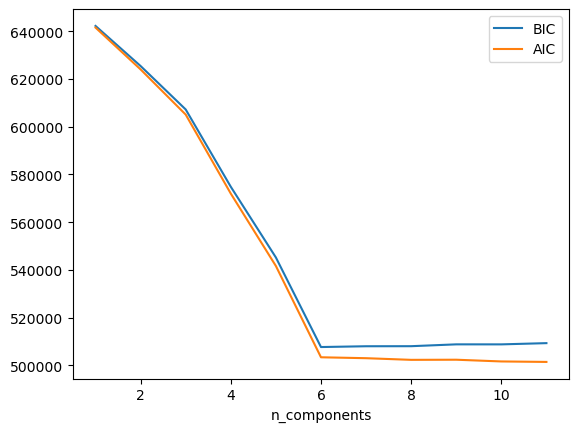

In [245]:
n_components = np.arange(1, 12)
models = [GaussianMixture(n, covariance_type='full', random_state=0).fit(standardized)
          for n in n_components]

plt.plot(n_components, [m.bic(standardized) for m in models], label='BIC')
plt.plot(n_components, [m.aic(standardized) for m in models], label='AIC')
plt.legend(loc='best')
plt.xlabel('n_components')

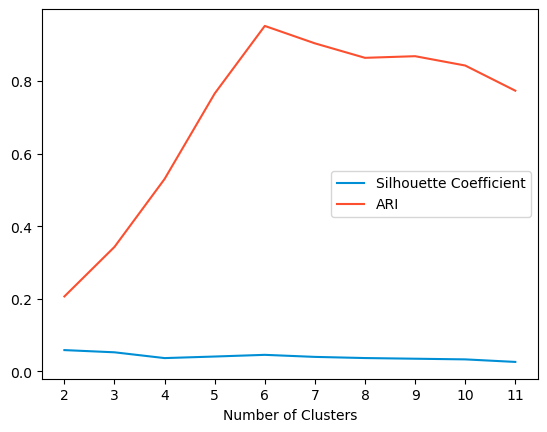

In [246]:
silhouette_coefficients = []
ari_scores = []
n_clusters = np.arange(2,12)
for k in n_clusters:
    gmm = GaussianMixture(n_components=k)
    gmm.fit(standardized)
    labels = gmm.predict(standardized)
    score = silhouette_score(standardized, labels)
    silhouette_coefficients.append(score)
    ari = adjusted_rand_score(true_labels, labels)
    ari_scores.append(ari)

plt.plot(n_clusters, silhouette_coefficients, c="#008fd5", label="Silhouette Coefficient")
plt.plot(n_clusters, ari_scores, c="#fc4f30", label="ARI")
plt.xticks(n_clusters)
plt.xlabel('Number of Clusters')
plt.legend()
plt.show()

--------------------------------------

Na osnovu prethodnih dijagrama, vidimo da je optimalan broj klastera i za ovaj model upravo ocekivanih 6.

---------------------

In [135]:
from sklearn.mixture import GaussianMixture
from sklearn.decomposition import PCA
import plotly as py
import plotly.graph_objs as go
from plotly.offline import download_plotlyjs, init_notebook_mode, plot, iplot

gmm = GaussianMixture(n_components=6)
gmm.fit(standardized)
clusters_pred = gmm.predict(standardized)

gmm_pca_3d = PCA(n_components=3)
gmm_PCs_3d = pd.DataFrame(gmm_pca_3d.fit_transform(standardized))
gmm_PCs_3d.columns = ["PC1_3d", "PC2_3d", "PC3_3d"]

df_gmm = dataframe.copy()
df_gmm['Predicted_Cluster'] = clusters_pred
# df_gmm['Predicted_Cluster'] = true_labels

gmm_plotX = pd.concat([df_gmm,gmm_PCs_3d], axis=1, join='inner')
gmm_plotX["dummy"] = 0

gmm_cluster0 = gmm_plotX[gmm_plotX["Predicted_Cluster"] == 0]
gmm_cluster1 = gmm_plotX[gmm_plotX["Predicted_Cluster"] == 1]
gmm_cluster2 = gmm_plotX[gmm_plotX["Predicted_Cluster"] == 2]
gmm_cluster3 = gmm_plotX[gmm_plotX["Predicted_Cluster"] == 3]
gmm_cluster4 = gmm_plotX[gmm_plotX["Predicted_Cluster"] == 4]
gmm_cluster5 = gmm_plotX[gmm_plotX["Predicted_Cluster"] == 5]

init_notebook_mode(connected=True)

trace1 = go.Scatter3d(x = gmm_cluster0["PC1_3d"], y = gmm_cluster0["PC2_3d"], z = gmm_cluster0["PC3_3d"],
                    mode = "markers", name = "Cluster 0", marker = dict(color = 'rgba(255, 128, 255, 0.8)'), text = None)
trace2 = go.Scatter3d(x = gmm_cluster1["PC1_3d"], y = gmm_cluster1["PC2_3d"], z = gmm_cluster1["PC3_3d"],
                    mode = "markers", name = "Cluster 1", marker = dict(color = 'rgba(255, 128, 2, 0.8)'), text = None)
trace3 = go.Scatter3d(x = gmm_cluster2["PC1_3d"], y = gmm_cluster2["PC2_3d"], z = gmm_cluster2["PC3_3d"],
                    mode = "markers", name = "Cluster 2", marker = dict(color = 'rgba(0, 255, 200, 0.8)'), text = None)
trace4 = go.Scatter3d(x = gmm_cluster3["PC1_3d"], y = gmm_cluster3["PC2_3d"], z = gmm_cluster3["PC3_3d"],
                    mode = "markers", name = "Cluster 3", marker = dict(color = 'rgba(255, 255, 0, 0.8)'), text = None)
trace5 = go.Scatter3d(x = gmm_cluster4["PC1_3d"], y = gmm_cluster4["PC2_3d"], z = gmm_cluster4["PC3_3d"],
                    mode = "markers", name = "Cluster 4", marker = dict(color = 'rgba(0, 128, 2, 0.8)'), text = None)
trace6 = go.Scatter3d(x = gmm_cluster5["PC1_3d"], y = gmm_cluster5["PC2_3d"], z = gmm_cluster5["PC3_3d"],
                    mode = "markers", name = "Cluster 5", marker = dict(color = 'rgba(0, 0, 255, 0.8)'), text = None)

gmm_data = [trace1, trace2, trace3, trace4, trace5, trace6]
# data = [trace6, trace5, trace4, trace3, trace2, trace1]
# data = [trace1, trace2, trace3]
title = "Visualizing Clusters in Three Dimensions Using PCA"
layout = dict(title = title,
              xaxis= dict(title= 'PC1',ticklen= 10,zeroline= False),
              yaxis= dict(title= 'PC2',ticklen= 10,zeroline= False)
             )

fig = dict(data = gmm_data, layout = layout)

iplot(fig)

	       hours       num_of_courses       scores                 true_labels
	    DS  FE  BE    DS FE BE DS FE BE   DS  FE  BE      a_BE a_DS a_FE b_BE b_DS b_FE
	    -------------------------------------------------------------------------------
Cluster 0: [31. 50. 30.] [5. 3. 5. 5. 3. 5.] [72. 72. 71.] - [3206   12    8   19   10    4]
Cluster 1: [30. 30. 51.] [3. 3. 5. 3. 3. 3.] [59. 72. 72.] - [   8   15    6   19 3142   17]
Cluster 2: [31. 50. 31.] [3. 3. 3. 3. 5. 3.] [71. 72. 72.] - [   8   18   21 3074   27   14]
Cluster 3: [50. 30. 31.] [3. 5. 3. 3. 5. 3.] [71. 59. 59.] - [  10   13   13    8    6 3155]
Cluster 4: [50. 50. 30.] [5. 3. 5. 3. 5. 3.] [59. 59. 72.] - [  23 3177   12   12   22   11]
Cluster 5: [30. 51. 50.] [3. 5. 3. 3. 5. 3.] [59. 72. 58.] - [   8   15 3184   15    8    8]


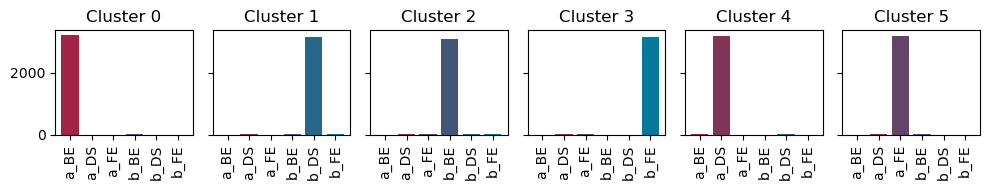

In [249]:
print("\t       hours       num_of_courses       scores                 true_labels")
print("\t    DS  FE  BE    DS FE BE DS FE BE   DS  FE  BE      a_BE a_DS a_FE b_BE b_DS b_FE")
print("\t    -------------------------------------------------------------------------------")

fig, ax = plt.subplots(1,6, sharey=True, tight_layout=True, figsize=(10,2))

for i in range(6):
    indices = df_gmm.index[df_gmm['Predicted_Cluster'] == i].to_list()
    labels, counts = np.unique(true_labels[indices], return_counts=True)
    hours = df_gmm[df_gmm['Predicted_Cluster'] == i].iloc[:,0:3].median().to_numpy()
    courses = df_gmm[df_gmm['Predicted_Cluster'] == i].iloc[:,3:9].median().to_numpy()
    scores = df_gmm[df_gmm['Predicted_Cluster'] == i].iloc[:,9:12].median().to_numpy()
    
    print("Cluster {}: {} {} {} - {}".format(i, hours, courses, scores, counts))
    
    ax[i].bar(range(6), counts, color=['#a12345', '#823456', '#634567', '#445678', '#256789', '#06789a'])
    ax[i].set_xticks(range(6), labels=["a_BE", "a_DS", "a_FE", "b_BE", "b_DS", "b_FE"], rotation=90)
    ax[i].set_title("Cluster {}".format(i))


--------------------------------------

Moze se videti da se svaki od predvidjenih klastera poklapa sa svakom od labela.

---------------------

In [261]:
from sklearn.model_selection import KFold, cross_validate

cv = KFold(n_splits=10, random_state=1, shuffle=True)

gm = GaussianMixture(n_components=6)
n_scores = cross_validate(gm, standardized, true_labels, scoring='adjusted_rand_score', cv=cv, n_jobs=-1, return_train_score=True)
n_scores

{'fit_time': array([1.25634313, 1.30963564, 1.35093021, 1.35052228, 1.27237344,
        1.32526255, 1.30361962, 1.39779782, 0.39492726, 0.41066861]),
 'score_time': array([0.0156219 , 0.        , 0.01562691, 0.01562095, 0.01562428,
        0.01561975, 0.        , 0.        , 0.        , 0.        ]),
 'test_score': array([0.95187991, 0.94896646, 0.94840747, 0.9510089 , 0.94745275,
        0.96422875, 0.94760426, 0.95567792, 0.94740595, 0.95793564]),
 'train_score': array([0.95262228, 0.95196271, 0.9524915 , 0.95246977, 0.95196347,
        0.95100492, 0.95180571, 0.95154351, 0.95275748, 0.95199697])}

--------------------------------------

Koriscenjem unakrsne validacije, ustanovljeno je da se ne radi o overfit-u, tako da je ovaj model za sada najbolji.

---------------------

### 2.2 Klasterizacija normalizovanih podataka:

--------------------------------------

U ovom koraku se pokusava sa klasterizacijom normalizovanih podataka, kako bi se, po mogucstvu, dobila bolja i/ili inutitivnija klasterizacija.

---------------------

**1. Kmeans**

In [73]:
from sklearn.cluster import KMeans

kmeans_n = KMeans(init='random',  
                n_clusters=6,
                n_init=10,
                max_iter=300,
                random_state=42)
kmeans_n.fit(normalized)
kmeans_n.inertia_

889.406819335892

In [74]:
from sklearn.decomposition import PCA
import plotly as py
import plotly.graph_objs as go
from plotly.offline import download_plotlyjs, init_notebook_mode, plot, iplot

kmeans_n = KMeans(init='random', n_clusters=6, n_init=10, max_iter=300, random_state=42)
kmeans_n.fit(normalized)
predicted_clusters = kmeans_n.predict(normalized)

pca_1d = PCA(n_components=1)
pca_2d = PCA(n_components=2)
pca_3d = PCA(n_components=3)

PCs_1d = pd.DataFrame(pca_1d.fit_transform(normalized))
PCs_2d = pd.DataFrame(pca_2d.fit_transform(normalized))
PCs_3d = pd.DataFrame(pca_3d.fit_transform(normalized))

PCs_1d.columns = ["PC1_1d"]
PCs_2d.columns = ["PC1_2d", "PC2_2d"]
PCs_3d.columns = ["PC1_3d", "PC2_3d", "PC3_3d"]

dataframe['Predicted_Cluster'] = predicted_clusters
# dataframe['Predicted_Cluster'] = true_labels
plotX = pd.concat([dataframe,PCs_3d], axis=1, join='inner')
plotX["dummy"] = 0

cluster0 = plotX[plotX["Predicted_Cluster"] == 0]
cluster1 = plotX[plotX["Predicted_Cluster"] == 1]
cluster2 = plotX[plotX["Predicted_Cluster"] == 2]
cluster3 = plotX[plotX["Predicted_Cluster"] == 3]
cluster4 = plotX[plotX["Predicted_Cluster"] == 4]
cluster5 = plotX[plotX["Predicted_Cluster"] == 5]

init_notebook_mode(connected=True)

In [75]:
trace1 = go.Scatter3d(x = cluster0["PC1_3d"],
                    y = cluster0["PC2_3d"],
                    z = cluster0["PC3_3d"],
                    mode = "markers",
                    name = "Cluster 0",
                    marker = dict(color = 'rgba(255, 128, 255, 0.8)'),
                    text = None)
trace2 = go.Scatter3d(x = cluster1["PC1_3d"],
                    y = cluster1["PC2_3d"],
                    z = cluster1["PC3_3d"],
                    mode = "markers",
                    name = "Cluster 1",
                    marker = dict(color = 'rgba(255, 128, 2, 0.8)'),
                    text = None)
trace3 = go.Scatter3d(x = cluster2["PC1_3d"],
                    y = cluster2["PC2_3d"],
                    z = cluster2["PC3_3d"],
                    mode = "markers",
                    name = "Cluster 2",
                    marker = dict(color = 'rgba(0, 255, 200, 0.8)'),
                    text = None)
trace4 = go.Scatter3d(x = cluster3["PC1_3d"],
                    y = cluster3["PC2_3d"],
                    z = cluster3["PC3_3d"],
                    mode = "markers",
                    name = "Cluster 3",
                    marker = dict(color = 'rgba(255, 255, 0, 0.8)'),
                    text = None)
trace5 = go.Scatter3d(x = cluster4["PC1_3d"],
                    y = cluster4["PC2_3d"],
                    z = cluster4["PC3_3d"],
                    mode = "markers",
                    name = "Cluster 4",
                    marker = dict(color = 'rgba(0, 128, 2, 0.8)'),
                    text = None)
trace6 = go.Scatter3d(x = cluster5["PC1_3d"],
                    y = cluster5["PC2_3d"],
                    z = cluster5["PC3_3d"],
                    mode = "markers",
                    name = "Cluster 5",
                    marker = dict(color = 'rgba(0, 0, 255, 0.8)'),
                    text = None)

# data = [trace1, trace2, trace3, trace4, trace5, trace6]
data = [trace6, trace5, trace4, trace3, trace2, trace1]
# data = [trace1, trace2, trace3]
title = "Visualizing Clusters in Three Dimensions Using PCA"
layout = dict(title = title,
              xaxis= dict(title= 'PC1',ticklen= 10,zeroline= False),
              yaxis= dict(title= 'PC2',ticklen= 10,zeroline= False)
             )

fig = dict(data = data, layout = layout)

iplot(fig)

In [81]:
from sklearn import metrics

print(' rand score:',metrics.rand_score(true_labels, kmeans_n.labels_),'\n',
     'ajusted rand score:',metrics.adjusted_rand_score(true_labels, kmeans_n.labels_),'\n',
     'ajusted mutual info score:',metrics.adjusted_mutual_info_score(true_labels, kmeans_n.labels_),'\n',
      'silhouette score:',metrics.silhouette_score(normalized, kmeans_n.labels_))

 rand score: 0.7572119173602314 
 ajusted rand score: 0.1360487586783296 
 ajusted mutual info score: 0.19155762908511903 
 silhouette score: 0.17105370101470438


**2. Agglomerative:**

In [80]:
from sklearn.cluster import AgglomerativeClustering


ac_n= AgglomerativeClustering(n_clusters=6, affinity='euclidean', linkage='ward')
ac_n.fit(normalized)
ac_n.labels_

array([1, 3, 0, ..., 3, 4, 0], dtype=int64)

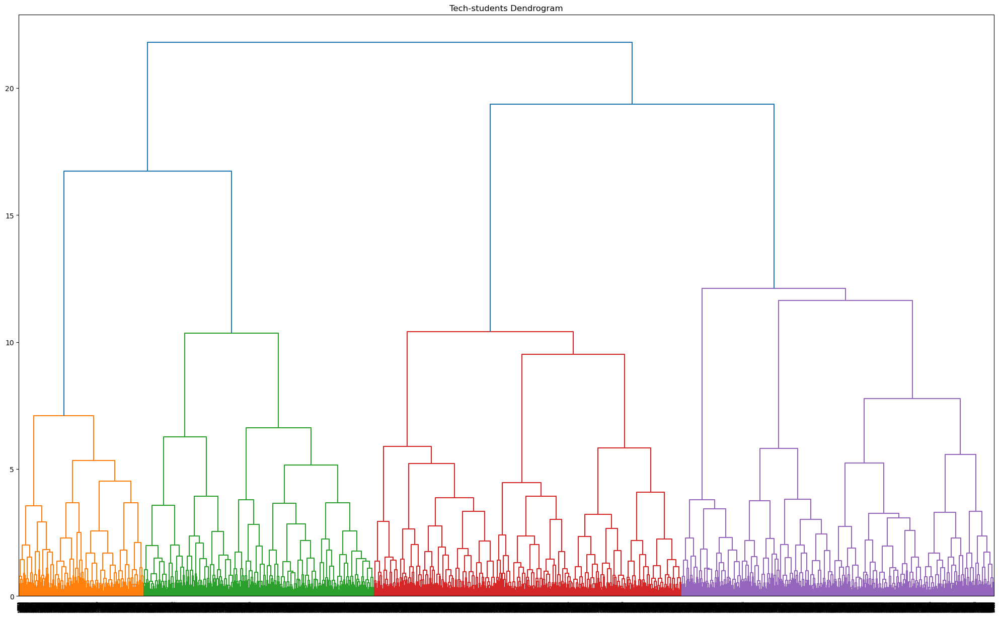

In [71]:
import scipy.cluster.hierarchy as shc
import matplotlib.pyplot as plt

plt.figure(figsize=(25, 15))
plt.title("Tech-students Dendrogram")
clusters = shc.linkage(normalized, 
            method='ward', 
            metric="euclidean")
shc.dendrogram(Z=clusters)
plt.show()

In [94]:
from sklearn import metrics

print(' rand score:',metrics.rand_score(true_labels, ac_n.labels_),'\n',
     'ajusted rand score:',metrics.adjusted_rand_score(true_labels, ac_n.labels_),'\n',
     'ajusted mutual info score:',metrics.adjusted_mutual_info_score(true_labels, ac_n.labels_),'\n',
     'silhouette score',metrics.silhouette_score(normalized, ac_n.labels_))

 rand score: 0.7432659863256187 
 ajusted rand score: 0.12138985968884579 
 ajusted mutual info score: 0.17324686115299331 
 silhouette score 0.10212031751110064


Sa 4 klastera (po dendrogramu):

In [128]:
from sklearn.cluster import AgglomerativeClustering


ac2_n= AgglomerativeClustering(n_clusters=4, affinity='euclidean', linkage='ward')
ac2_n.fit(normalized)
ac2_n.labels_

array([0, 3, 1, ..., 3, 0, 1], dtype=int64)

In [129]:
from sklearn import metrics

print(' rand score:',metrics.rand_score(true_labels, ac2_n.labels_),'\n',
     'ajusted rand score:',metrics.adjusted_rand_score(true_labels, ac2_n.labels_),'\n',
     'ajusted mutual info score:',metrics.adjusted_mutual_info_score(true_labels, ac2_n.labels_),'\n',
     'silhouette score',metrics.silhouette_score(normalized, ac2_n.labels_))

 rand score: 0.6901489627196897 
 ajusted rand score: 0.11029237261059405 
 ajusted mutual info score: 0.14473967229030116 
 silhouette score 0.12021567844593413


**3. MeanShift**

In [88]:
from sklearn.cluster import MeanShift

meanshift_n = MeanShift()
meanshift_n.fit(normalized)
meanshift_n.n_iter_, meanshift.labels_[:5]

(6, array([0, 0, 0, 0, 0], dtype=int64))

In [89]:
np.unique(meanshift_n.labels_)

array([0], dtype=int64)

In [92]:
from sklearn import metrics

print(' rand score:',metrics.rand_score(true_labels, meanshift_n.labels_),'\n',
     'ajusted rand score:',metrics.adjusted_rand_score(true_labels, meanshift_n.labels_),'\n',
     'ajusted mutual info score:',metrics.adjusted_mutual_info_score(true_labels, meanshift_n.labels_),'\n',
     )

 rand score: 0.16664707815337088 
 ajusted rand score: 0.0 
 ajusted mutual info score: -1.251614496997333e-17 



**4. DBSCAN**

In [95]:
from sklearn.cluster import DBSCAN

dbscan_n = DBSCAN(eps=2.5, min_samples=24)  #min_samples se obicno postavlja na 2*broj_featurea
dbscan_n.fit(normalized)
# dbscan.fit(dataframe.to_numpy())
dbscan.labels_

array([0, 0, 0, ..., 0, 0, 0], dtype=int64)

In [99]:
from sklearn import metrics

print(' rand score:',metrics.rand_score(true_labels, dbscan_n.labels_),'\n',
     'ajusted rand score:',metrics.adjusted_rand_score(true_labels, dbscan_n.labels_),'\n',
     'ajusted mutual info score:',metrics.adjusted_mutual_info_score(true_labels, dbscan_n.labels_),'\n',
     )

 rand score: 0.16664707815337088 
 ajusted rand score: 0.0 
 ajusted mutual info score: -1.251614496997333e-17 



**5. Spectral Clustering**

Affinity je RBF kernel:

In [103]:
from sklearn.cluster import SpectralClustering 

sc_n= SpectralClustering(n_clusters = 6, affinity ='rbf')
sc_n.fit(normalized)
sc_n.labels_

array([4, 4, 3, ..., 4, 5, 3])

In [104]:
from sklearn import metrics

print(' rand score:',metrics.rand_score(true_labels, sc_n.labels_),'\n',
     'ajusted rand score:',metrics.adjusted_rand_score(true_labels, sc_n.labels_),'\n',
     'ajusted mutual info score:',metrics.adjusted_mutual_info_score(true_labels, sc_n.labels_),'\n',
      'silhouette_score:',metrics.silhouette_score(normalized, sc_n.labels_)
     )

 rand score: 0.7596332760469261 
 ajusted rand score: 0.14033639232826084 
 ajusted mutual info score: 0.20235184368895487 
 silhouette_score: 0.14263658781650457


Affinity je Euklidska distanca:

In [105]:
from sklearn.cluster import SpectralClustering 

scnn_n= SpectralClustering(n_clusters = 6, affinity ='nearest_neighbors')
scnn_n.fit(normalized)
scnn_n.labels_

array([2, 3, 1, ..., 4, 5, 2])

In [106]:
from sklearn import metrics

print(' rand score:',metrics.rand_score(true_labels, scnn_n.labels_),'\n',
     'ajusted rand score:',metrics.adjusted_rand_score(true_labels, scnn_n.labels_),'\n',
     'ajusted mutual info score:',metrics.adjusted_mutual_info_score(true_labels, scnn_n.labels_),'\n',
      'silhouette_score:',metrics.silhouette_score(normalized, scnn_n.labels_)
     )

 rand score: 0.728851446154832 
 ajusted rand score: 0.11675636237243434 
 ajusted mutual info score: 0.20136302635589973 
 silhouette_score: 0.15746172009278991


-----------------

**7. Affinity Propagation**

In [41]:
from sklearn.cluster import AffinityPropagation
af_n = AffinityPropagation(preference=-50)
af_n.fit(normalized)
af_n.labels_

array([178, 143, 263, ..., 148, 174, 115], dtype=int64)

In [42]:
silhouette_score(normalized, af_n.labels_)

0.06563070807294047

In [43]:
adjusted_rand_score(true_labels, af_n.labels_)

0.02106124421473517

-----------

Klasterizacija normalizovanih podataka je za sve algoritme gora nego sa standardizovanim.

-------

## 3. Klasterizacija u okviru labela

Zbog neintuitivnosti dodele labela studentima, ideja je pokusati dodatnu analizu klasterizacije ovih podatka, ali po labelama i po tri oblasti IT-ja, kako bi se po mogustvu utvrdio inicijalni kriterijum podele.

--------------------

In [ ]:
df_bDS = dataframe[dataframe['PROFILE'] == 'beginner_data_science'].copy()
df_bDS.drop('PROFILE', axis=1, inplace=True)
df_bBE = dataframe[dataframe['PROFILE'] == 'beginner_backend'].copy()
df_bBE.drop('PROFILE', axis=1, inplace=True)
df_bFE = dataframe[dataframe['PROFILE'] == 'beginner_front_end'].copy()
df_bFE.drop('PROFILE', axis=1, inplace=True)
df_aDS = dataframe[dataframe['PROFILE'] == 'advanced_data_science'].copy()
df_aDS.drop('PROFILE', axis=1, inplace=True)
df_aBE = dataframe[dataframe['PROFILE'] == 'advanced_backend'].copy()
df_aBE.drop('PROFILE', axis=1, inplace=True)
df_aFE = dataframe[dataframe['PROFILE'] == 'advanced_front_end'].copy()
df_aFE.drop('PROFILE', axis=1, inplace=True)

----------------

**3.1. KMeans**

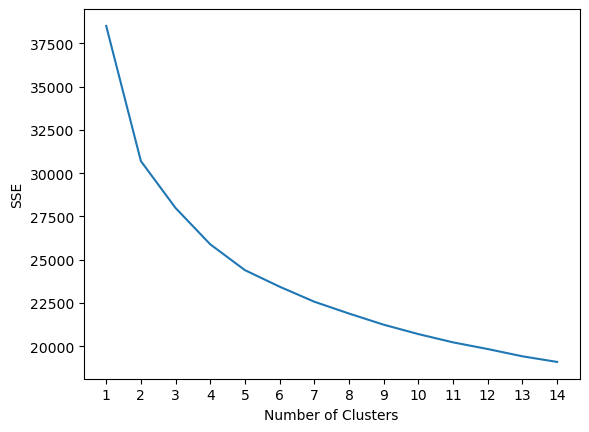

In [41]:
from sklearn.preprocessing import StandardScaler
from sklearn.cluster import KMeans

scaler = StandardScaler()
# standardized_bDS = scaler.fit_transform(df_bDS.to_numpy())
standardized_bFE = scaler.fit_transform(df_bFE.to_numpy())

kmeans_kwargs = {'init': 'random',
                 'n_init': 10,
                 'max_iter': 300,
                 'random_state': 42}

sse = []
for k in range(1,15):
    kmeans = KMeans(n_clusters=k, **kmeans_kwargs)
#     kmeans.fit(standardized_bDS)
    kmeans.fit(standardized_bFE)
    sse.append(kmeans.inertia_)

plt.plot(range(1,15), sse)
plt.xticks(range(1,15))
plt.xlabel('Number of Clusters')
plt.ylabel('SSE')
plt.show()

In [42]:
from kneed import KneeLocator

kl = KneeLocator(range(1,15), sse, curve='convex', direction='decreasing')
kl.elbow

5

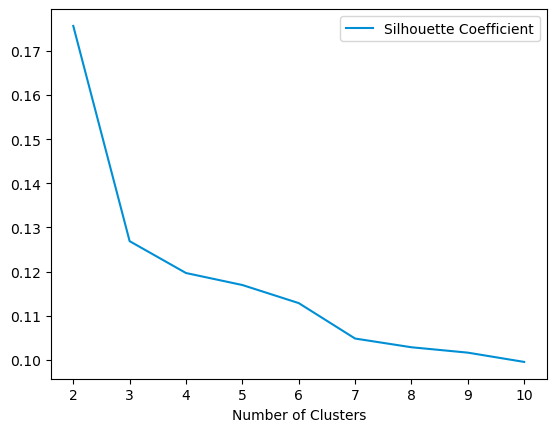

In [42]:
from sklearn.metrics import silhouette_score, adjusted_rand_score

silhouette_coefficients = []
for k in range(2,11):
    kmeans = KMeans(n_clusters=k, **kmeans_kwargs)
#     kmeans.fit(standardized_bDS)
    kmeans.fit(standardized_bFE)
#     score = silhouette_score(standardized_bDS, kmeans.labels_)
    score = silhouette_score(standardized_bFE, kmeans.labels_)
    silhouette_coefficients.append(score)

plt.plot(range(2,11), silhouette_coefficients, c="#008fd5", label="Silhouette Coefficient")
plt.xticks(range(2,11))
plt.xlabel('Number of Clusters')
plt.legend()
plt.show()

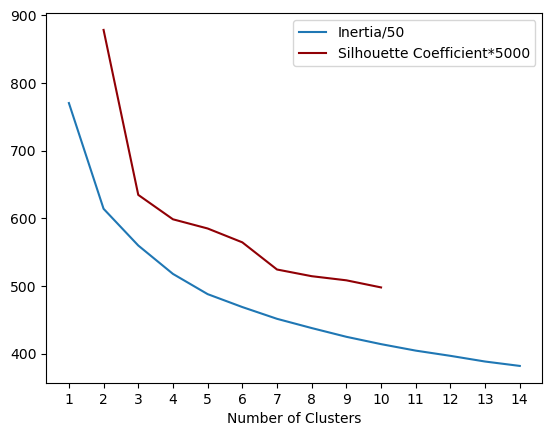

In [43]:
plt.plot(range(1,15), np.array(sse)/50, label="Inertia/50")
plt.plot(range(2,11), np.array(silhouette_coefficients)*5000, c="#900005", label="Silhouette Coefficient*5000")
plt.xticks(range(1,15))
plt.xlabel('Number of Clusters')
plt.legend()
plt.show()

In [43]:
from sklearn.decomposition import PCA
import plotly as py
import plotly.graph_objs as go
from plotly.offline import download_plotlyjs, init_notebook_mode, plot, iplot

kmeans = KMeans(init='random', n_clusters=3, n_init=10, max_iter=300, random_state=42)
# kmeans.fit(standardized_bDS)
# predicted_clusters_bDS = kmeans.predict(standardized_bDS)
kmeans.fit(standardized_bFE)
predicted_clusters_bFE = kmeans.predict(standardized_bFE)

pca_3d = PCA(n_components=3)
# PCs_3d = pd.DataFrame(pca_3d.fit_transform(standardized_bDS))
PCs_3d = pd.DataFrame(pca_3d.fit_transform(standardized_bFE))
PCs_3d.columns = ["PC1_3d", "PC2_3d", "PC3_3d"]

# df_bDS['Predicted_Cluster'] = predicted_clusters_bDS
# plotX = pd.concat([df_bDS,PCs_3d], axis=1, join='inner')
df_bFE['Predicted_Cluster'] = predicted_clusters_bFE
plotX = pd.concat([df_bFE,PCs_3d], axis=1, join='inner')
plotX["dummy"] = 0

cluster0 = plotX[plotX["Predicted_Cluster"] == 0]
cluster1 = plotX[plotX["Predicted_Cluster"] == 1]
cluster2 = plotX[plotX["Predicted_Cluster"] == 2]
# cluster3 = plotX[plotX["Predicted_Cluster"] == 3]
# cluster4 = plotX[plotX["Predicted_Cluster"] == 4]
# cluster5 = plotX[plotX["Predicted_Cluster"] == 5]

init_notebook_mode(connected=True)

trace1 = go.Scatter3d(x = cluster0["PC1_3d"],
                    y = cluster0["PC2_3d"],
                    z = cluster0["PC3_3d"],
                    mode = "markers",
                    name = "Cluster 0",
                    marker = dict(color = 'rgba(255, 128, 255, 0.8)'),
                    text = None)
trace2 = go.Scatter3d(x = cluster1["PC1_3d"],
                    y = cluster1["PC2_3d"],
                    z = cluster1["PC3_3d"],
                    mode = "markers",
                    name = "Cluster 1",
                    marker = dict(color = 'rgba(255, 128, 2, 0.8)'),
                    text = None)
trace3 = go.Scatter3d(x = cluster2["PC1_3d"],
                    y = cluster2["PC2_3d"],
                    z = cluster2["PC3_3d"],
                    mode = "markers",
                    name = "Cluster 2",
                    marker = dict(color = 'rgba(0, 255, 200, 0.8)'),
                    text = None)
# trace4 = go.Scatter3d(x = cluster3["PC1_3d"],
#                     y = cluster3["PC2_3d"],
#                     z = cluster3["PC3_3d"],
#                     mode = "markers",
#                     name = "Cluster 3",
#                     marker = dict(color = 'rgba(255, 255, 0, 0.8)'),
#                     text = None)
# trace5 = go.Scatter3d(x = cluster4["PC1_3d"],
#                     y = cluster4["PC2_3d"],
#                     z = cluster4["PC3_3d"],
#                     mode = "markers",
#                     name = "Cluster 4",
#                     marker = dict(color = 'rgba(0, 128, 2, 0.8)'),
#                     text = None)
# trace6 = go.Scatter3d(x = cluster5["PC1_3d"],
#                     y = cluster5["PC2_3d"],
#                     z = cluster5["PC3_3d"],
#                     mode = "markers",
#                     name = "Cluster 5",
#                     marker = dict(color = 'rgba(0, 0, 255, 0.8)'),
#                     text = None)

# data = [trace1, trace2, trace3, trace4, trace5, trace6]
# data = [trace6, trace5, trace4, trace3, trace2, trace1]
data = [trace1, trace2, trace3]#, trace4, trace5]
title = "Visualizing Clusters in Three Dimensions Using PCA"
layout = dict(title = title,
              xaxis= dict(title= 'PC1',ticklen= 10,zeroline= False),
              yaxis= dict(title= 'PC2',ticklen= 10,zeroline= False)
             )

fig = dict(data = data, layout = layout)

iplot(fig)

In [58]:
df_DS1 = dataframe[dataframe['PROFILE'] == 'beginner_data_science']
df_DS2 = dataframe[dataframe['PROFILE'] == 'advanced_data_science']
df_DS = pd.concat([df_DS1, df_DS2], axis=0)
df_DS.drop('PROFILE',axis=1, inplace=True)

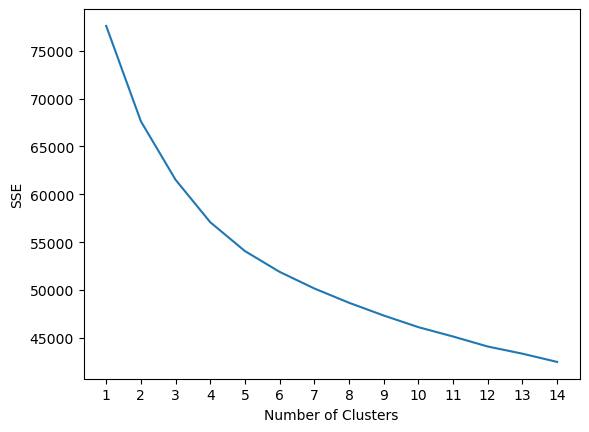

In [59]:
from sklearn.preprocessing import StandardScaler
from sklearn.cluster import KMeans

scaler = StandardScaler()
# standardized_bDS = scaler.fit_transform(df_bDS.to_numpy())
standardized_DS = scaler.fit_transform(df_DS.to_numpy())

kmeans_kwargs = {'init': 'random',
                 'n_init': 10,
                 'max_iter': 300,
                 'random_state': 42}

sse = []
for k in range(1,15):
    kmeans = KMeans(n_clusters=k, **kmeans_kwargs)
#     kmeans.fit(standardized_bDS)
    kmeans.fit(standardized_DS)
    sse.append(kmeans.inertia_)

plt.plot(range(1,15), sse)
plt.xticks(range(1,15))
plt.xlabel('Number of Clusters')
plt.ylabel('SSE')
plt.show()

In [60]:
from kneed import KneeLocator

kl = KneeLocator(range(1,15), sse, curve='convex', direction='decreasing')
kl.elbow

5

In [62]:
from sklearn.decomposition import PCA
import plotly as py
import plotly.graph_objs as go
from plotly.offline import download_plotlyjs, init_notebook_mode, plot, iplot

kmeans = KMeans(init='random', n_clusters=2, n_init=10, max_iter=300, random_state=42)
# kmeans.fit(standardized_bDS)
# predicted_clusters_bDS = kmeans.predict(standardized_bDS)
kmeans.fit(standardized_DS)
predicted_clusters_bFE = kmeans.predict(standardized_DS)

pca_3d = PCA(n_components=3)
# PCs_3d = pd.DataFrame(pca_3d.fit_transform(standardized_bDS))
PCs_3d = pd.DataFrame(pca_3d.fit_transform(standardized_DS))
PCs_3d.columns = ["PC1_3d", "PC2_3d", "PC3_3d"]

# df_bDS['Predicted_Cluster'] = predicted_clusters_bDS
# plotX = pd.concat([df_bDS,PCs_3d], axis=1, join='inner')
df_DS['Predicted_Cluster'] = predicted_clusters_bFE
plotX = pd.concat([df_DS,PCs_3d], axis=1, join='inner')
plotX["dummy"] = 0

cluster0 = plotX[plotX["Predicted_Cluster"] == 0]
cluster1 = plotX[plotX["Predicted_Cluster"] == 1]
# cluster2 = plotX[plotX["Predicted_Cluster"] == 2]
# cluster3 = plotX[plotX["Predicted_Cluster"] == 3]
# cluster4 = plotX[plotX["Predicted_Cluster"] == 4]
# cluster5 = plotX[plotX["Predicted_Cluster"] == 5]

init_notebook_mode(connected=True)

trace1 = go.Scatter3d(x = cluster0["PC1_3d"],
                    y = cluster0["PC2_3d"],
                    z = cluster0["PC3_3d"],
                    mode = "markers",
                    name = "Cluster 0",
                    marker = dict(color = 'rgba(255, 128, 255, 0.8)'),
                    text = None)
trace2 = go.Scatter3d(x = cluster1["PC1_3d"],
                    y = cluster1["PC2_3d"],
                    z = cluster1["PC3_3d"],
                    mode = "markers",
                    name = "Cluster 1",
                    marker = dict(color = 'rgba(255, 128, 2, 0.8)'),
                    text = None)
# trace3 = go.Scatter3d(x = cluster2["PC1_3d"],
#                     y = cluster2["PC2_3d"],
#                     z = cluster2["PC3_3d"],
#                     mode = "markers",
#                     name = "Cluster 2",
#                     marker = dict(color = 'rgba(0, 255, 200, 0.8)'),
#                     text = None)
# trace4 = go.Scatter3d(x = cluster3["PC1_3d"],
#                     y = cluster3["PC2_3d"],
#                     z = cluster3["PC3_3d"],
#                     mode = "markers",
#                     name = "Cluster 3",
#                     marker = dict(color = 'rgba(255, 255, 0, 0.8)'),
#                     text = None)
# trace5 = go.Scatter3d(x = cluster4["PC1_3d"],
#                     y = cluster4["PC2_3d"],
#                     z = cluster4["PC3_3d"],
#                     mode = "markers",
#                     name = "Cluster 4",
#                     marker = dict(color = 'rgba(0, 128, 2, 0.8)'),
#                     text = None)
# trace6 = go.Scatter3d(x = cluster5["PC1_3d"],
#                     y = cluster5["PC2_3d"],
#                     z = cluster5["PC3_3d"],
#                     mode = "markers",
#                     name = "Cluster 5",
#                     marker = dict(color = 'rgba(0, 0, 255, 0.8)'),
#                     text = None)

# data = [trace1, trace2, trace3, trace4, trace5, trace6]
# data = [trace6, trace5, trace4, trace3, trace2, trace1]
data = [trace1, trace2]#, trace3, trace4, trace5]
title = "Visualizing Clusters in Three Dimensions Using PCA"
layout = dict(title = title,
              xaxis= dict(title= 'PC1',ticklen= 10,zeroline= False),
              yaxis= dict(title= 'PC2',ticklen= 10,zeroline= False)
             )

fig = dict(data = data, layout = layout)

iplot(fig)

**3.2 Agglomerative:**

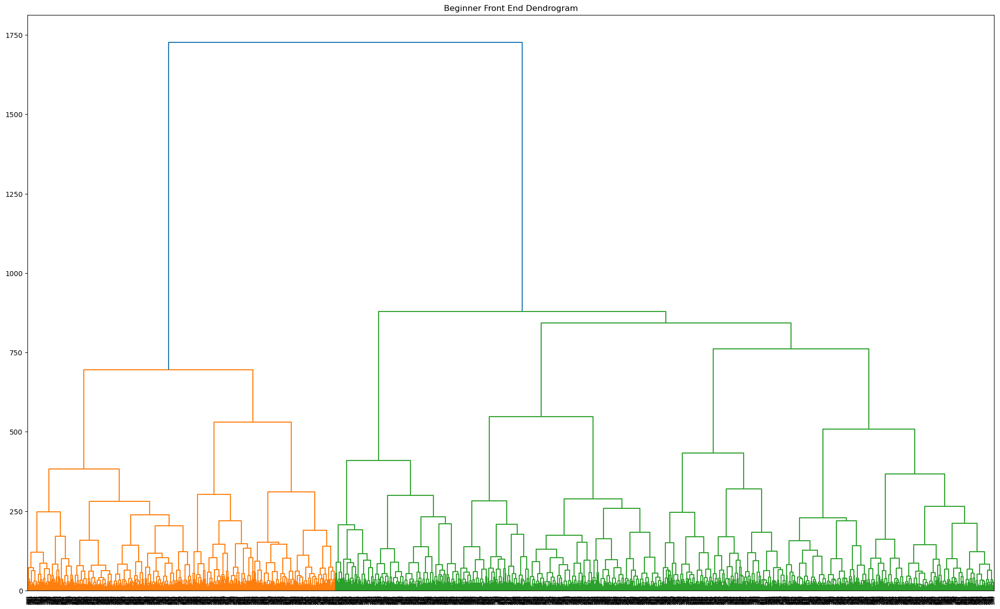

In [139]:
import scipy.cluster.hierarchy as shc
import matplotlib.pyplot as plt

plt.figure(figsize=(25, 15))
plt.title("Beginner Front End Dendrogram")
clusters = shc.linkage(df_bFE, 
            method='ward', 
            metric="euclidean")
shc.dendrogram(Z=clusters)
plt.show()

In [141]:
standardized_bFE = scaler.fit_transform(df_bFE.to_numpy())
from sklearn.cluster import AgglomerativeClustering
ac_bfe= AgglomerativeClustering(n_clusters=2, affinity='euclidean', linkage='ward')
ac_bfe.fit(standardized_bFE)
ac_bfe.labels_

array([1, 0, 0, ..., 0, 0, 0], dtype=int64)

In [143]:
dataframe.drop(['Predicted_Cluster'], axis=1)
predicted_clusters=ac_bfe.labels_
from sklearn.decomposition import PCA
import plotly as py
import plotly.graph_objs as go
from plotly.offline import download_plotlyjs, init_notebook_mode, plot, iplot

pca_1d = PCA(n_components=1)
pca_2d = PCA(n_components=2)
pca_3d = PCA(n_components=3)

PCs_1d = pd.DataFrame(pca_1d.fit_transform(standardized_bFE))
PCs_2d = pd.DataFrame(pca_2d.fit_transform(standardized_bFE))
PCs_3d = pd.DataFrame(pca_3d.fit_transform(standardized_bFE))

PCs_1d.columns = ["PC1_1d"]
PCs_2d.columns = ["PC1_2d", "PC2_2d"]
PCs_3d.columns = ["PC1_3d", "PC2_3d", "PC3_3d"]

df_bFE['Predicted_Cluster'] = predicted_clusters
# dataframe['Predicted_Cluster'] = true_labels
plotX = pd.concat([df_bFE,PCs_3d], axis=1, join='inner')
plotX["dummy"] = 0

cluster0 = plotX[plotX["Predicted_Cluster"] == 0]
cluster1 = plotX[plotX["Predicted_Cluster"] == 1]
init_notebook_mode(connected=True)

In [144]:
trace1 = go.Scatter3d(x = cluster0["PC1_3d"],
                    y = cluster0["PC2_3d"],
                    z = cluster0["PC3_3d"],
                    mode = "markers",
                    name = "Cluster 0",
                    marker = dict(color = 'rgba(255, 128, 255, 0.8)'),
                    text = None)
trace2 = go.Scatter3d(x = cluster1["PC1_3d"],
                    y = cluster1["PC2_3d"],
                    z = cluster1["PC3_3d"],
                    mode = "markers",
                    name = "Cluster 1",
                    marker = dict(color = 'rgba(255, 128, 2, 0.8)'),
                    text = None)


data = [trace2, trace1]
title = "Visualizing Clusters in Three Dimensions Using PCA"
layout = dict(title = title,
              xaxis= dict(title= 'PC1',ticklen= 10,zeroline= False),
              yaxis= dict(title= 'PC2',ticklen= 10,zeroline= False)
             )

fig = dict(data = data, layout = layout)

iplot(fig)

--------------------------------------

U okviru labela, sve ove podele su jako lose i iz njih se nista ne moze zakljuciti.

---------------------

## 4. Zakljucak

Analizom algoritama klasterizacije i njihovih rezultata zakljuceno je da Gaussian Mixture daje najbolje rezultate. Preslikavanje dobijenih klastera na labele je skoro bijektivno. Medjutim, detaljna analiza rezultata klasterizacije nije otkrila na koji nacin su se inicijalno ove labele dodeljivale. Na primer, za Beginner Data Science labelu, po boxplot-ovima se vidi da studenti kojima je dodeljena ova labela imaju najvise sati provedenih u ucenju Front End-a i najmanju ocenu bas na testovima iz oblasti Data Science, sto nije logicno. Uprkos tome, Gaussian Mixture, i malo gore Spectral Clustering, su uspeli da identifikuju neki kriterijum podele, i da dodele bas te labele. Zakljuceno je da je za dalju analizu potreban domenski ekspert koji bi otkrio na koji nacin su dodeljivani profili ovih studenata i koji bi objasnio prethodno navedeni primer.